In [ ]:
!pip install torch
!pip install pyro
!pip install pyroved
!pip install atomai


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.8/298.8 kB 5.9 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 732.8/732.8 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.9/37.9 MB 47.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for matplotlib: filename=matplotlib-3.3.4-cp310-cp310-linux_x86_64.whl size=11684759 sha256=93c98052dc5558538006fbcd2846511a63ba7647f4b

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.6/162.6 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 52.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 kB 20.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 266.1/266.1 kB 32.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.6/175.6 kB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 60.0 MB/s eta 0:00:00
  Created wheel for mendeleev: filename=mendeleev-0.6.1-py2.py3-none-any.whl size=174959 sha256=c7a8e5c9e126de09648e666ed1963b419b37f9ec1910141df1e1854dfa34b113
  Stored in directory: /root/.cache/pip/wheels/58/dc/35/3fa57a6ef1956eb96f1c261442ccb8a0f34a7f9d7403d82c96
Successfully built mendeleev
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.3.4
    Uninstalling matplotlib-3.3.4:
      Successfully uninstalled matplotlib-3.3.4
ERROR: pip

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import gdown
import cv2
#import kornia as K
import numpy as np
#from mpl_toolkits.axes_grid1 import make_axes_locatable
import pyroved as pv
import h5py
import atomai as aoi
import skimage
from skimage import filters
from skimage import color
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed, chan_vese, clear_border
from skimage.segmentation import mark_boundaries
from skimage.restoration import denoise_bilateral
from scipy import fftpack


#Custom loss Class
import weakref
import torch
import pyro
import pyro.infer as infer
import pyro.optim as optim
import warnings
import pyro.ops.jit
from pyro import poutine
from pyro.distributions.util import is_identically_zero
from pyro.infer.elbo import ELBO
from pyro.infer.abstract_infer import TracePosterior
from pyro.infer.enum import get_importance_trace
from pyro.infer.util import (
    MultiFrameTensor,
    get_plate_stacks,
    is_validation_enabled,
    torch_item,
)
from pyro.util import check_if_enumerated, warn_if_nan

# Custom trainer class
from torch.cuda import random
from typing import Type, Optional, Union




from pyroved.utils.nn import set_deterministic_mode

tt = torch.tensor

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


Set font sizes for figures:

In [ ]:
# set plot font sizes
SMALL_SIZE = 20
MEDIUM_SIZE = 25
BIGGER_SIZE = 30

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

## VAE on experimental images

### BF

Download and show the image:

Downloading...
From: https://drive.google.com/uc?id=1RfgsiN2DyfbtfpaVNKUDomNza_sCiRyb
To: /content/BF 200kx-5.jpg
100% 885k/885k [00:00<00:00, 29.7MB/s]


(-0.5, 2047.5, -0.5, 2047.5)

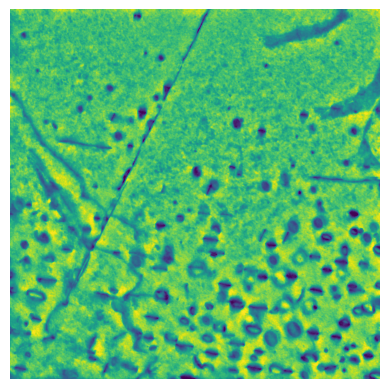

In [ ]:
#!gdown https://drive.google.com/uc?id=13EPnAvoICvB7WcCM6j42qguYEGh-Lecw
#BF200kx = cv2.imread("BF 200kx (2um) (Normalised - Gauss Blur 60.tif", 0)
!gdown https://drive.google.com/uc?id=1RfgsiN2DyfbtfpaVNKUDomNza_sCiRyb
BF200kx = cv2.imread("BF 200kx-5.jpg", 0)
plt.imshow(BF200kx, cmap="viridis", origin="lower")
plt.axis('off')

In [ ]:
window_size = 48
step_size = 8

work_image = BF200kx #temp
d1 = int((work_image.shape[0]-window_size/2)/step_size- 2)
d2 = int((work_image.shape[1]-window_size/2)/step_size- 2)

coordinates = aoi.utils.get_coord_grid(work_image, step_size)
imstack_grid, com_grid, frames_grid = aoi.utils.extract_subimages(work_image, coordinates, window_size)

Initialize data loader:

In [ ]:
imstack_grid = (imstack_grid - imstack_grid.min()) / (imstack_grid.max() - imstack_grid.min())

for i, el in enumerate(imstack_grid):
  imstack_grid[i] = (el - el.min()) / (el.max() - el.min())

train_data = torch.tensor(imstack_grid[:,:,:,0]).float()
train_loader = pv.utils.init_dataloader(train_data.unsqueeze(1), batch_size=64) # batch size need to be square term for customized shVAE

In [ ]:
print(train_data.shape)

torch.Size([63001, 48, 48])


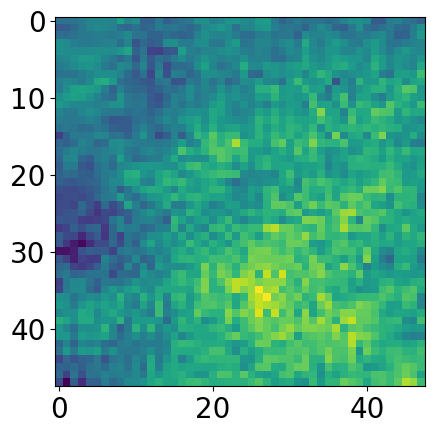

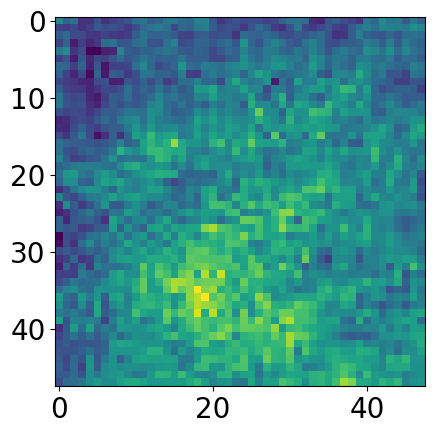

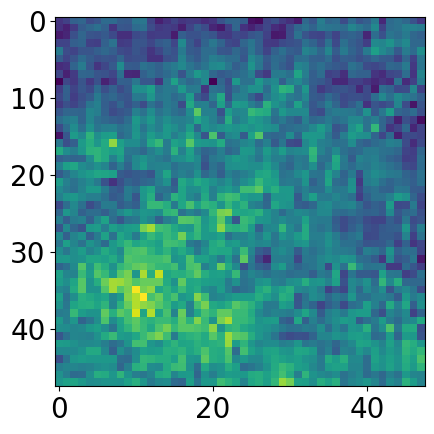

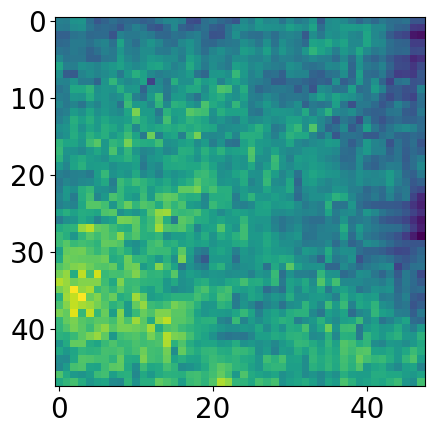

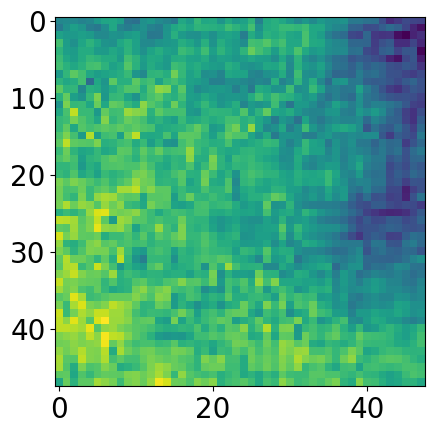

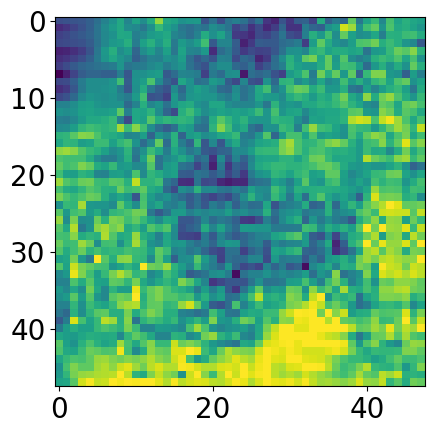

In [ ]:
#First input image
plt.imshow(train_data[0,:,:])

# Middle images
for i in range(0, 5):
  plt.imshow(train_data[i+100,:,:])
  plt.show()

#Last input image
plt.imshow(train_data[-1,:,:])

In [ ]:
in_dim = (window_size,window_size)

# Initialize shift-invariant VAE
sh_vae = pv.models.iVAE(in_dim, latent_dim=2, invariances = ['t'], seed=1, dx_prior=0.5, dy_prior=0.5)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(sh_vae)

# Train for n epochs:
kl_scale = torch.linspace(0.1, 1, 50)
for e in range(50):
    sc = kl_scale[e] if e < len(kl_scale) else kl_scale[-1]
    trainer.step(train_loader, scale_factor=sc)
    trainer.print_statistics()

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Epoch: 1 Training loss: 1535.5700
Epoch: 2 Training loss: 1512.5254
Epoch: 3 Training loss: 1507.9698
Epoch: 4 Training loss: 1504.6923
Epoch: 5 Training loss: 1501.3804
Epoch: 6 Training loss: 1496.7686
Epoch: 7 Training loss: 1492.5317
Epoch: 8 Training loss: 1489.5314
Epoch: 9 Training loss: 1487.5522
Epoch: 10 Training loss: 1486.5043
Epoch: 11 Training loss: 1484.9951
Epoch: 12 Training loss: 1484.5022
Epoch: 13 Training loss: 1483.4749
Epoch: 14 Training loss: 1482.9223
Epoch: 15 Training loss: 1483.0787
Epoch: 16 Training loss: 1482.1852
Epoch: 17 Training loss: 1482.3146
Epoch: 18 Training loss: 1482.4345
Epoch: 19 Training loss: 1481.8144
Epoch: 20 Training loss: 1481.9274
Epoch: 21 Training loss: 1481.4418
Epoch: 22 Training loss: 1482.0736
Epoch: 23 Training loss: 1481.6277
Epoch: 24 Training loss: 1481.7455
Epoch: 25 Training loss: 1481.7156
Epoch: 26 Training loss: 1481.9378
Epoch: 27 Training loss: 1481.7144
Epoch: 28 Training loss: 1482.2524
Epoch: 29 Training loss: 1482

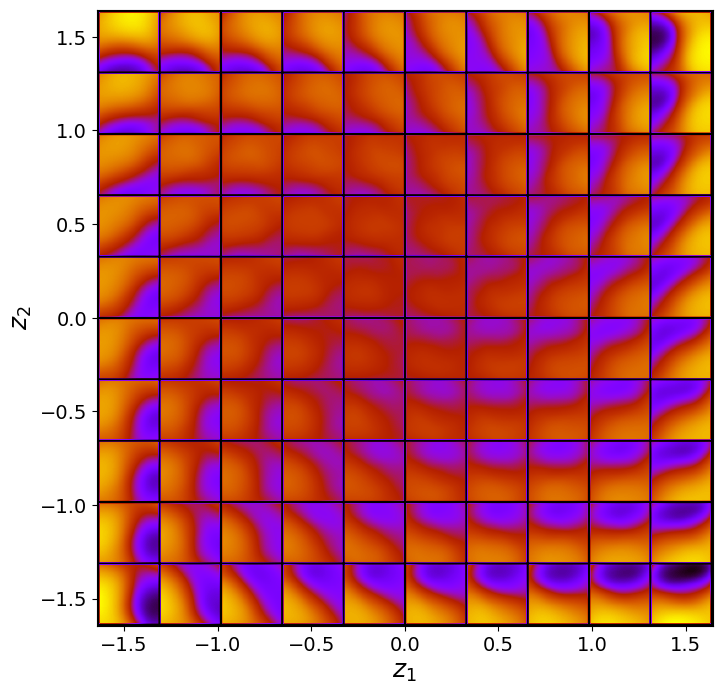

tensor([[[0.7534, 0.7606, 0.7675,  ..., 0.7866, 0.7799, 0.7730],
         [0.7587, 0.7654, 0.7718,  ..., 0.7851, 0.7781, 0.7709],
         [0.7632, 0.7694, 0.7754,  ..., 0.7835, 0.7763, 0.7689],
         ...,
         [0.2968, 0.2860, 0.2761,  ..., 0.4487, 0.4643, 0.4790],
         [0.2814, 0.2710, 0.2615,  ..., 0.4409, 0.4577, 0.4735],
         [0.2675, 0.2576, 0.2485,  ..., 0.4347, 0.4527, 0.4697]],

        [[0.6321, 0.6462, 0.6591,  ..., 0.7511, 0.7474, 0.7435],
         [0.6439, 0.6567, 0.6683,  ..., 0.7524, 0.7486, 0.7446],
         [0.6543, 0.6658, 0.6763,  ..., 0.7538, 0.7498, 0.7458],
         ...,
         [0.2892, 0.2824, 0.2761,  ..., 0.5314, 0.5461, 0.5601],
         [0.2788, 0.2722, 0.2660,  ..., 0.5252, 0.5412, 0.5564],
         [0.2694, 0.2629, 0.2570,  ..., 0.5206, 0.5378, 0.5542]],

        [[0.5326, 0.5509, 0.5683,  ..., 0.7264, 0.7238, 0.7211],
         [0.5447, 0.5619, 0.5782,  ..., 0.7293, 0.7266, 0.7238],
         [0.5560, 0.5721, 0.5872,  ..., 0.7322, 0.7293, 0.

In [ ]:
sh_vae.manifold2d(d=10, pad_value=.1)

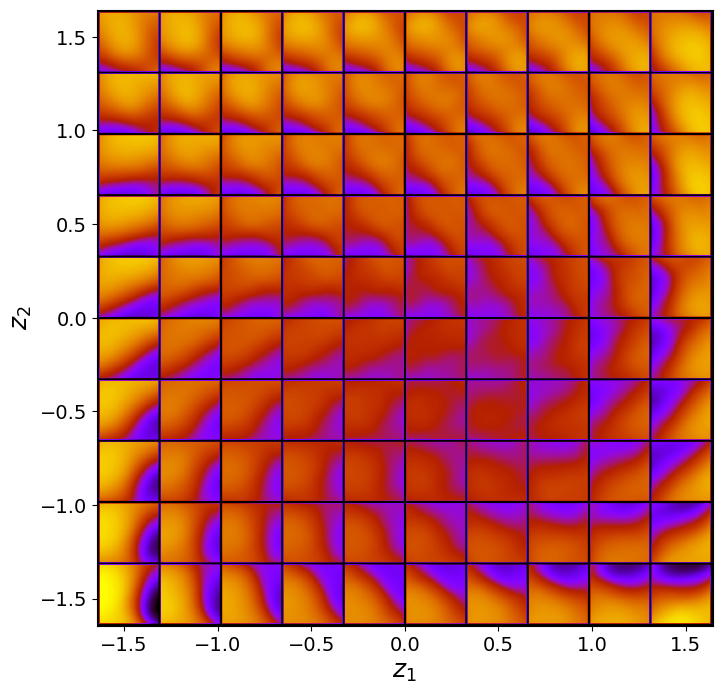

tensor([[[0.8011, 0.8053, 0.8091,  ..., 0.7476, 0.7460, 0.7445],
         [0.8015, 0.8057, 0.8095,  ..., 0.7427, 0.7409, 0.7392],
         [0.8015, 0.8057, 0.8096,  ..., 0.7378, 0.7358, 0.7338],
         ...,
         [0.3919, 0.3971, 0.4027,  ..., 0.6819, 0.6846, 0.6866],
         [0.3724, 0.3771, 0.3822,  ..., 0.6884, 0.6917, 0.6941],
         [0.3536, 0.3578, 0.3624,  ..., 0.6944, 0.6981, 0.7008]],

        [[0.7962, 0.8019, 0.8070,  ..., 0.7308, 0.7285, 0.7266],
         [0.7978, 0.8033, 0.8083,  ..., 0.7271, 0.7245, 0.7221],
         [0.7991, 0.8045, 0.8094,  ..., 0.7233, 0.7203, 0.7175],
         ...,
         [0.3760, 0.3785, 0.3813,  ..., 0.7463, 0.7476, 0.7479],
         [0.3528, 0.3548, 0.3572,  ..., 0.7487, 0.7500, 0.7504],
         [0.3308, 0.3325, 0.3345,  ..., 0.7500, 0.7514, 0.7520]],

        [[0.7864, 0.7937, 0.8002,  ..., 0.7119, 0.7098, 0.7081],
         [0.7896, 0.7966, 0.8030,  ..., 0.7086, 0.7060, 0.7039],
         [0.7923, 0.7992, 0.8054,  ..., 0.7052, 0.7021, 0.

In [ ]:
sh_vae.manifold2d(d=10, pad_value=.1)

In [ ]:
d1 = 253
d2 = 253

Text(0.5, 1.0, '$z_2$')

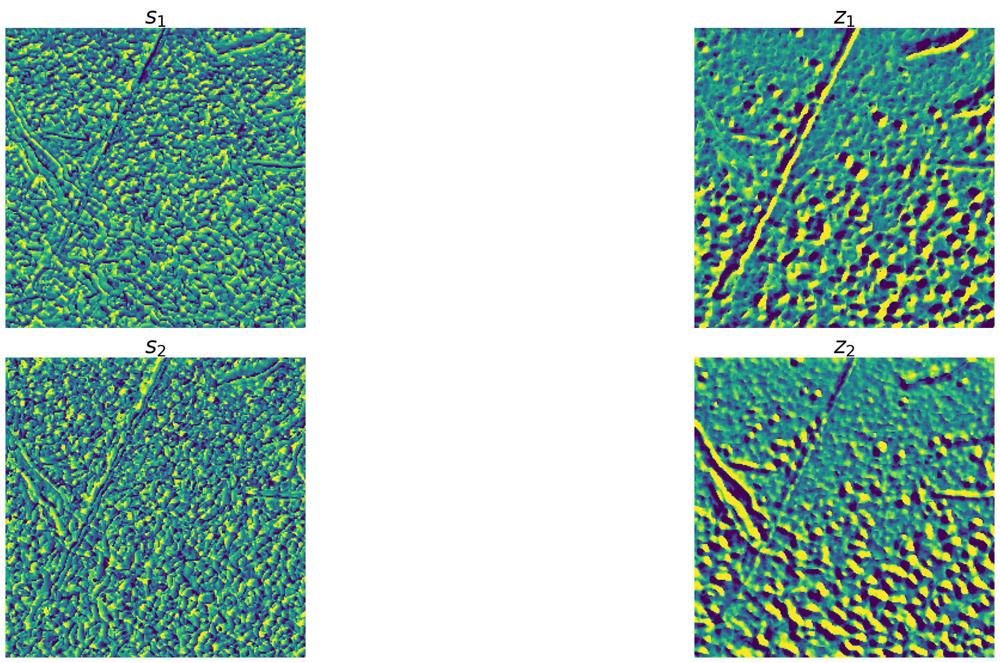

In [ ]:
z_mean, z_sd = sh_vae.encode(train_data)
fig = plt.figure(constrained_layout=True, figsize=(25, 12))
gs = fig.add_gridspec(2, 2)

ax2 = fig.add_subplot(gs[0, 0])
z_img = z_mean[:, 0].reshape(d1,d2)
z = ax2.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax2)
#cax2 = divider.append_axes("right", size="5%", pad=0.1)
#cbar2 = fig.colorbar(z, cax=cax2)
ax2.axis('off')
ax2.set_title('$s_1$')

ax3 = fig.add_subplot(gs[1, 0])
z_img = z_mean[:, 1].reshape(d1,d2)
z = ax3.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax3)
#cax3 = divider.append_axes("right", size="5%", pad=0.1)
#cbar3 = fig.colorbar(z, cax=cax3)
ax3.axis('off')
ax3.set_title('$s_2$')

ax4 = fig.add_subplot(gs[0, 1])
z_img = z_mean[:, 2].reshape(d1,d2)
z = ax4.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax4)
#cax4 = divider.append_axes("right", size="5%", pad=0.1)
#cbar4 = fig.colorbar(z, cax=cax4)
ax4.axis('off')
ax4.set_title('$z_1$')

ax5 = fig.add_subplot(gs[1, 1])
z_img = z_mean[:, 3].reshape(d1,d2)
z = ax5.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax5)
#cax5 = divider.append_axes("right", size="5%", pad=0.1)
#cbar5 = fig.colorbar(z, cax=cax5)
ax5.axis('off')
ax5.set_title('$z_2$')

Text(0.5, 1.0, '$z_2$')

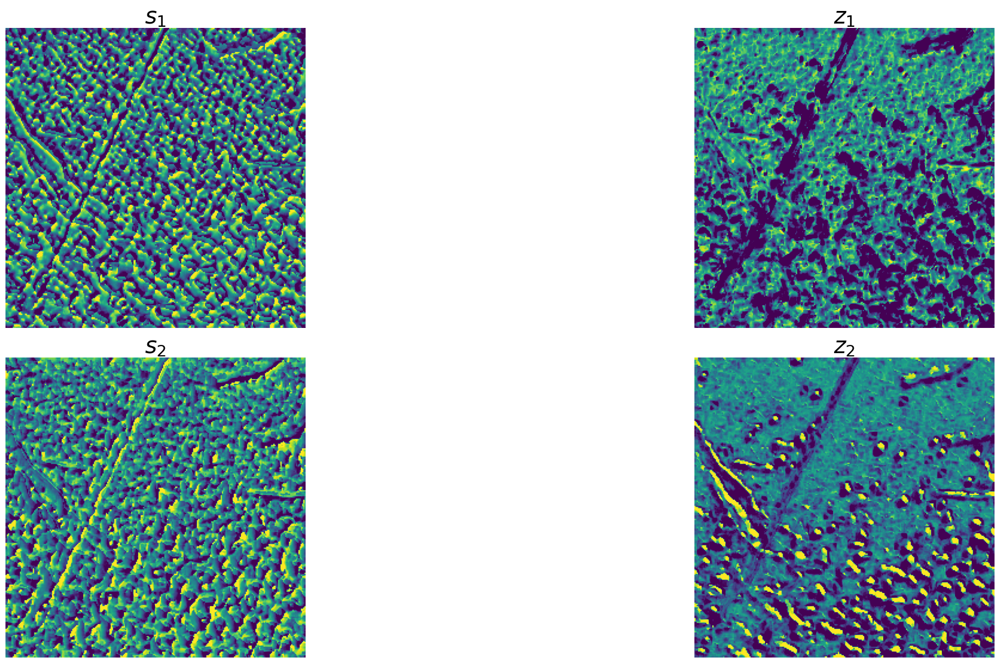

In [ ]:
z_mean, z_sd = sh_vae.encode(train_data)
fig = plt.figure(constrained_layout=True, figsize=(25, 12))
gs = fig.add_gridspec(2, 2)

ax2 = fig.add_subplot(gs[0, 0])
z_img = z_mean[:, 0].reshape(d1,d2)
z = ax2.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax2)
#cax2 = divider.append_axes("right", size="5%", pad=0.1)
#cbar2 = fig.colorbar(z, cax=cax2)
ax2.axis('off')
ax2.set_title('$s_1$')

ax3 = fig.add_subplot(gs[1, 0])
z_img = z_mean[:, 1].reshape(d1,d2)
z = ax3.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax3)
#cax3 = divider.append_axes("right", size="5%", pad=0.1)
#cbar3 = fig.colorbar(z, cax=cax3)
ax3.axis('off')
ax3.set_title('$s_2$')

ax4 = fig.add_subplot(gs[0, 1])
z_img = z_mean[:, 2].reshape(d1,d2)
z = ax4.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax4)
#cax4 = divider.append_axes("right", size="5%", pad=0.1)
#cbar4 = fig.colorbar(z, cax=cax4)
ax4.axis('off')
ax4.set_title('$z_1$')

ax5 = fig.add_subplot(gs[1, 1])
z_img = z_mean[:, 3].reshape(d1,d2)
z = ax5.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax5)
#cax5 = divider.append_axes("right", size="5%", pad=0.1)
#cbar5 = fig.colorbar(z, cax=cax5)
ax5.axis('off')
ax5.set_title('$z_2$')

torch.Size([63001, 4]) torch.Size([63001, 4])


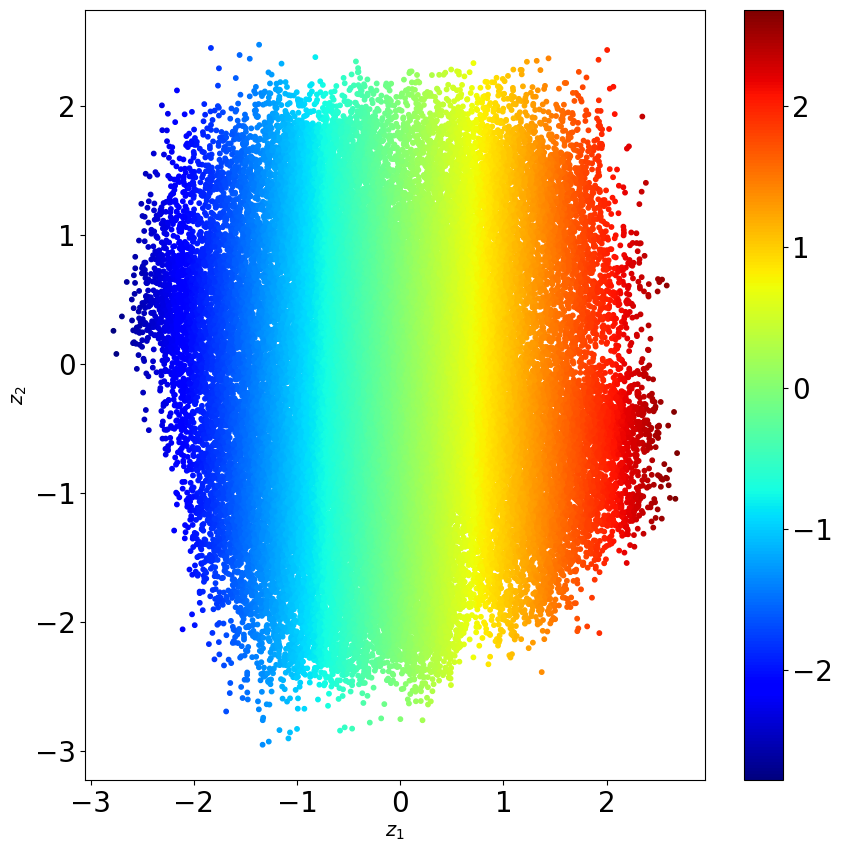

In [ ]:
train_D = train_loader.dataset.tensors[0]
#train_data = traj_sampled
z_mean, z_sd = sh_vae.encode(train_D)
print(z_mean.shape, z_mean.shape)

plt.figure(figsize=(10, 10))

plt.scatter(z_mean[:, 2], z_mean[:, 3], s=10, c=z_mean[:, 2], cmap='jet')

plt.xlabel("$z_1$", fontsize=14)
plt.ylabel("$z_2$", fontsize=14)
plt.colorbar()
plt.show()

torch.Size([63001, 4]) torch.Size([63001, 4])


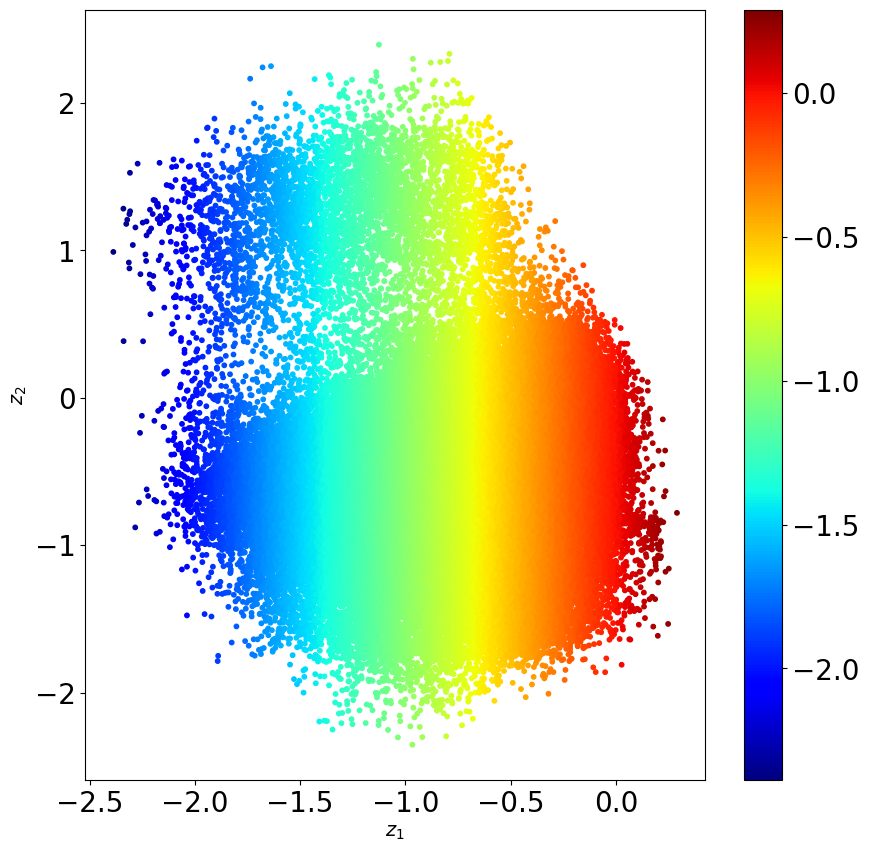

In [ ]:
train_D = train_loader.dataset.tensors[0]
#train_data = traj_sampled
z_mean, z_sd = sh_vae.encode(train_D)
print(z_mean.shape, z_mean.shape)

plt.figure(figsize=(10, 10))

plt.scatter(z_mean[:, 2], z_mean[:, 3], s=10, c=z_mean[:, 2], cmap='jet')

plt.xlabel("$z_1$", fontsize=14)
plt.ylabel("$z_2$", fontsize=14)
plt.colorbar()
plt.show()

In [ ]:
z = torch.vstack((z_mean[:, 2], z_mean[:, 3]))
z = torch.transpose(z, 0 ,1)
z.shape

torch.Size([63001, 2])

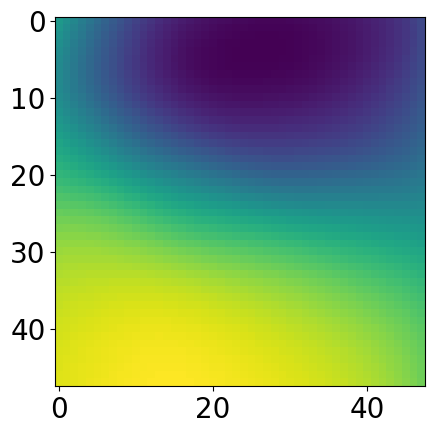

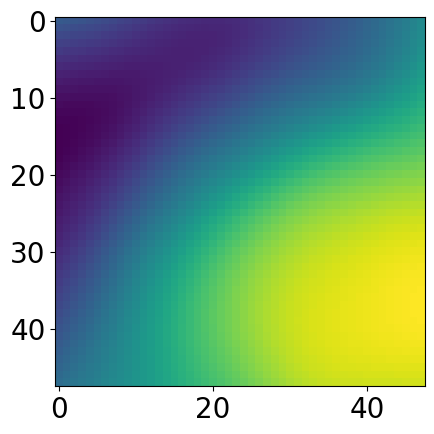

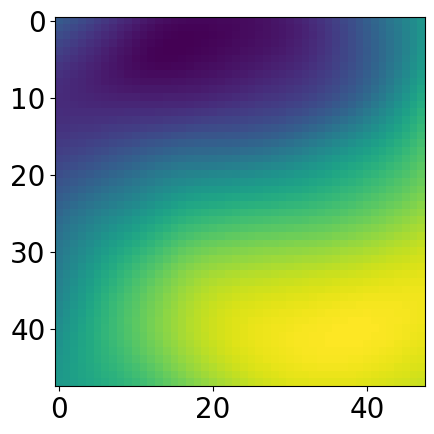

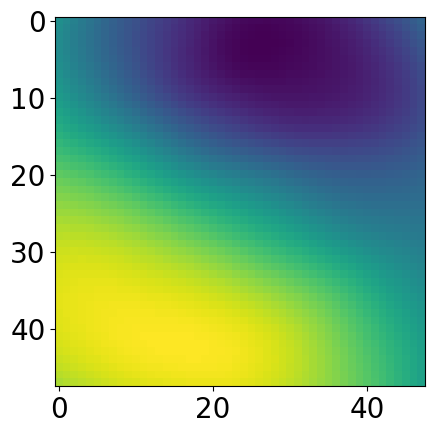

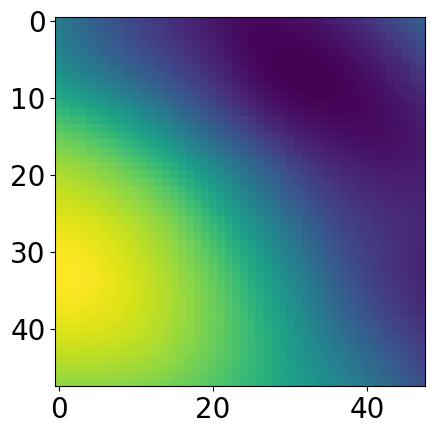

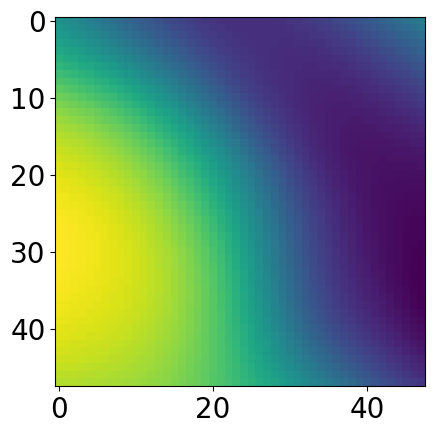

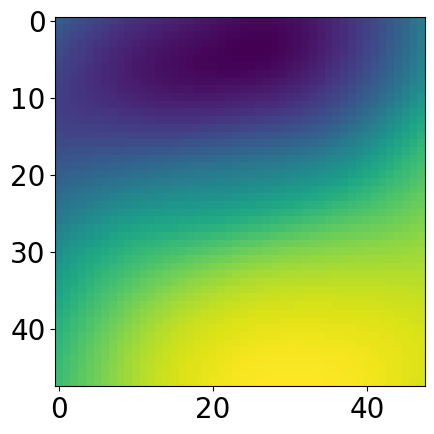

In [ ]:
#First reconstructed image
decoded = sh_vae.decode(z[0,:]).numpy()
plt.imshow(decoded[0,:,:].squeeze())
plt.show()

for i in range(0, 5):
  decoded = sh_vae.decode(z[i+100,:]).numpy()

  plt.imshow(decoded[0,:,:].squeeze())
  plt.show()

#Last reconstructed image
decoded = sh_vae.decode(z[-1,:]).numpy()
plt.imshow(decoded[0,:,:].squeeze())
plt.show()


In [ ]:
ssim_image = np.zeros_like(train_data)
for i in range(0, z.shape[0]):
  # print(i)
  input_img = train_data[i,:,:].numpy()
  decoded = sh_vae.decode(z[i,:]).numpy()
  recon_img = decoded[0, :, :]
  ssim_image[i, :, :] = (input_img-recon_img)**2

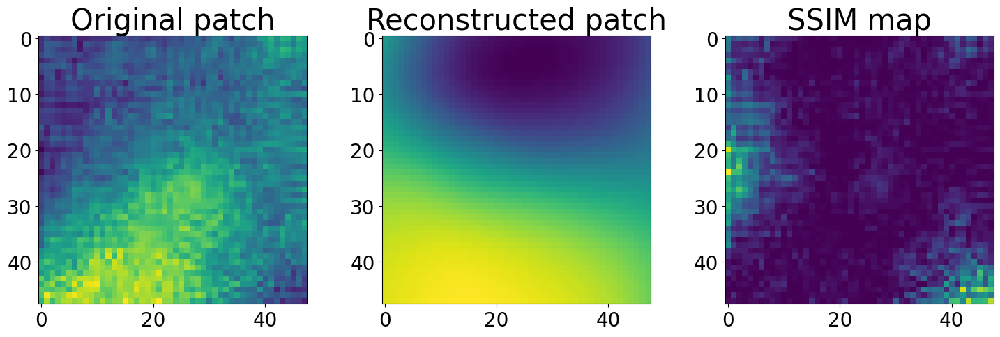

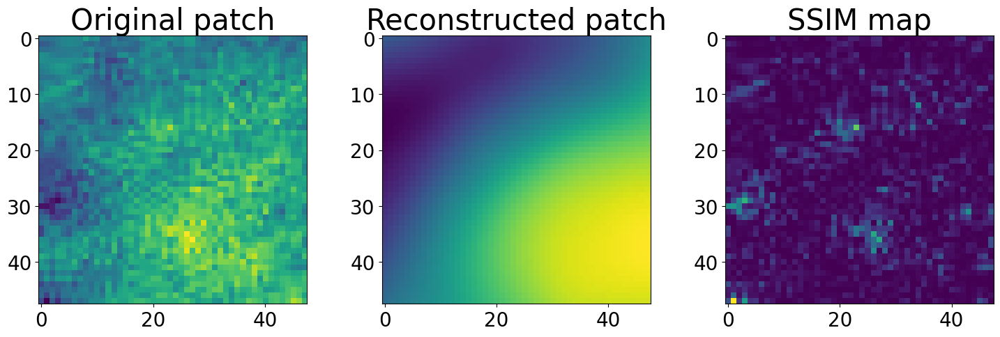

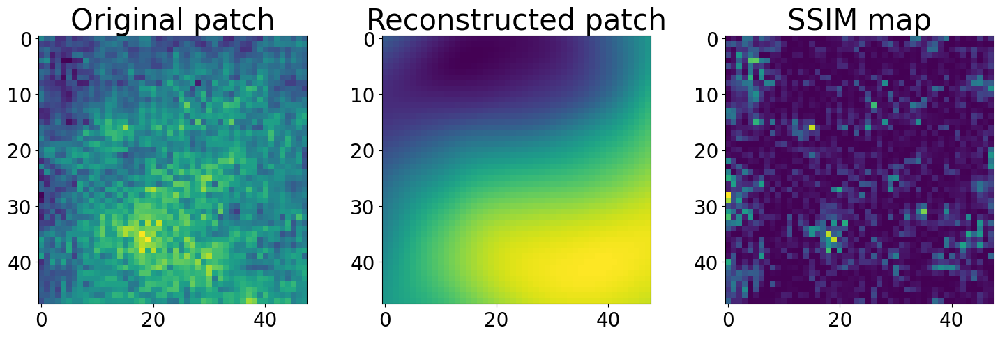

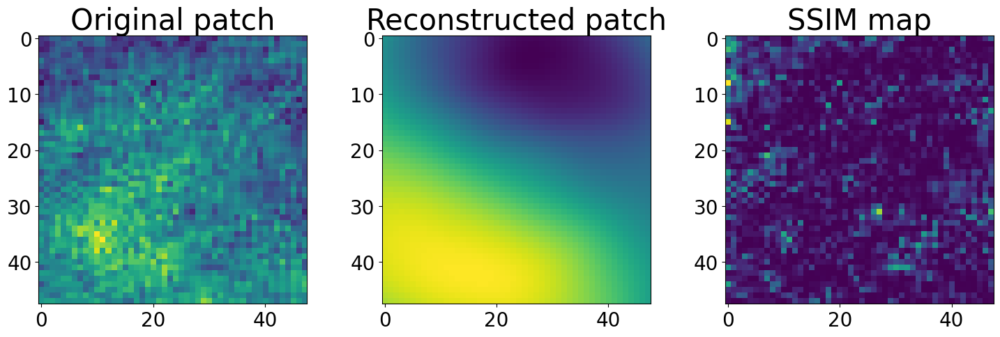

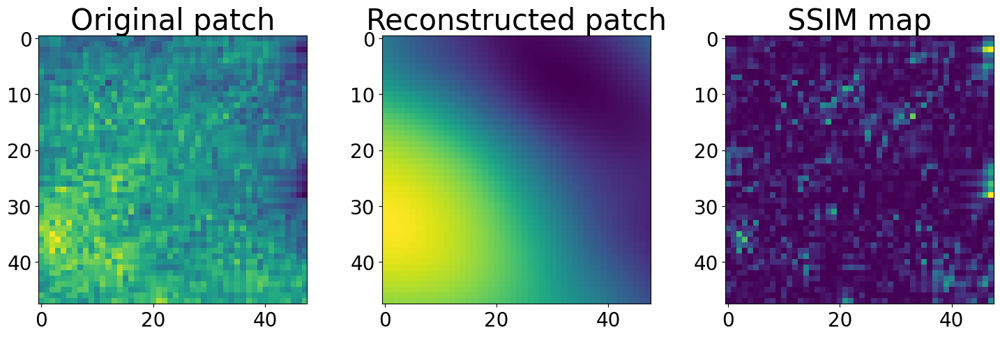

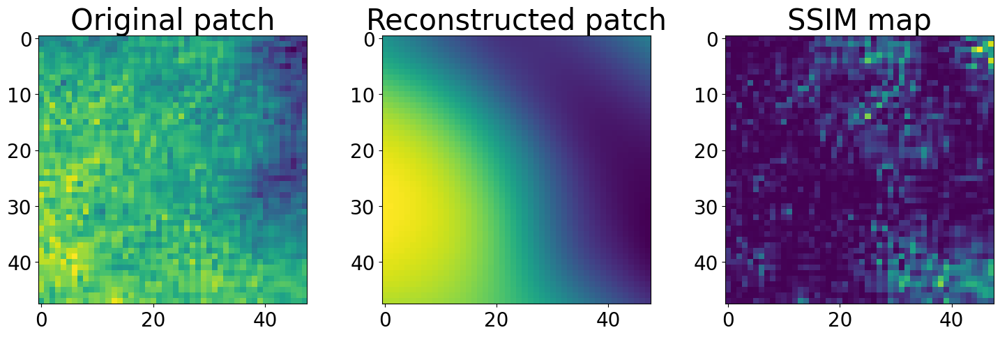

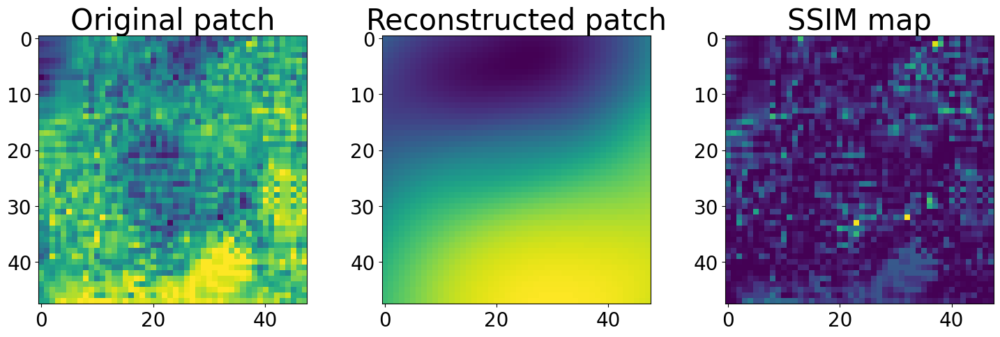

In [ ]:
#SSIM map between first original and reconstructed image patch
fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
ax[0].imshow(train_data[0,:,:])
ax[0].set_title("Original patch")
decoded = sh_vae.decode(z[0,:]).numpy()
ax[1].imshow(decoded[0,:,:].squeeze())
ax[1].set_title("Reconstructed patch")
ax[2].imshow(ssim_image[0, :, :])
ax[2].set_title("SSIM map")
plt.show()

for i in range(0, 5):
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
  ax[0].imshow(train_data[i+100,:,:])
  ax[0].set_title("Original patch")
  decoded = sh_vae.decode(z[i+100,:]).numpy()
  ax[1].imshow(decoded[0,:,:].squeeze())
  ax[1].set_title("Reconstructed patch")
  ax[2].imshow(ssim_image[i+100, :, :])
  ax[2].set_title("SSIM map")
  plt.show()

#Last reconstructed image
fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
ax[0].imshow(train_data[-1,:,:])
ax[0].set_title("Original patch")
decoded = sh_vae.decode(z[-1,:]).numpy()
ax[1].imshow(decoded[0,:,:].squeeze())
ax[1].set_title("Reconstructed patch")
ax[2].imshow(ssim_image[-1, :, :])
ax[2].set_title("SSIM map")
plt.show()


In [ ]:
from skimage.metrics import structural_similarity as ssim
from skimage.restoration import denoise_bilateral

In [ ]:
ssim_image_fullmap = np.zeros(z.shape[0])
d =  np.sqrt(z.shape[0])
for i in range(0, z.shape[0]):
  # print(i)
  input_img = train_data[i,:,:].numpy()
  decoded = sh_vae.decode(z[i,:]).numpy()
  recon_img = decoded[0, :, :]
  ssim_image_fullmap[i] = ssim(input_img, recon_img, data_range=recon_img.max() - recon_img.min())
ssim_image_fullmap= np.reshape(ssim_image_fullmap, (d1,d2))

In [ ]:
z1 = denoise_bilateral(ssim_image_fullmap, sigma_color=0.05, sigma_spatial=5)
z1.shape

(251, 251)

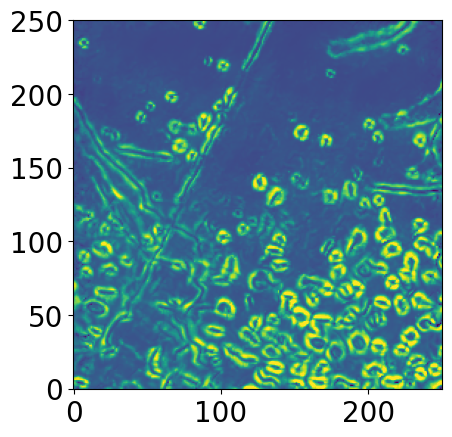

In [ ]:
plt.imshow(z1, cmap="viridis", origin="lower", vmin=z1.min()/1.5, vmax=z1.max()/1.5)

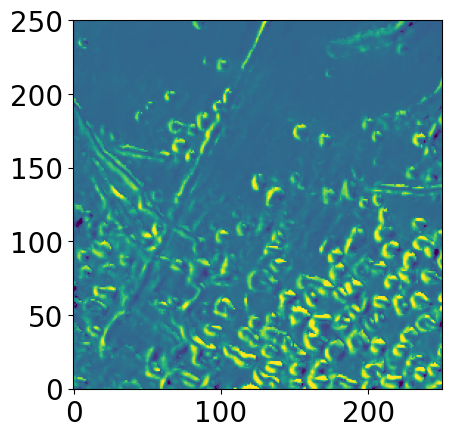

In [ ]:
plt.imshow(z1, cmap="viridis", origin="lower", vmin=z1.min()/1.5, vmax=z1.max()/1.5)

#r-VAE

In [ ]:
in_dim = (window_size,window_size)

# Initialize shift-invariant VAE
r_vae = pv.models.iVAE(in_dim, latent_dim=2, invariances = ['r'], seed=1, dx_prior=0.5, dy_prior=0.5)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(r_vae)

# Train for n epochs:
kl_scale = torch.linspace(0.01, 0.05, 50)
for e in range(50):
    sc = kl_scale[e] if e < len(kl_scale) else kl_scale[-1]
    trainer.step(train_loader, scale_factor=sc)
    trainer.print_statistics()

Epoch: 1 Training loss: 1524.1920
Epoch: 2 Training loss: 1502.0667
Epoch: 3 Training loss: 1493.6348
Epoch: 4 Training loss: 1487.9738
Epoch: 5 Training loss: 1484.8051
Epoch: 6 Training loss: 1483.8955
Epoch: 7 Training loss: 1482.6634
Epoch: 8 Training loss: 1482.5185
Epoch: 9 Training loss: 1482.7124
Epoch: 10 Training loss: 1482.2813
Epoch: 11 Training loss: 1481.4538
Epoch: 12 Training loss: 1481.9195
Epoch: 13 Training loss: 1482.3100
Epoch: 14 Training loss: 1480.8840
Epoch: 15 Training loss: 1480.8867
Epoch: 16 Training loss: 1481.3066
Epoch: 17 Training loss: 1482.3366
Epoch: 18 Training loss: 1481.6577
Epoch: 19 Training loss: 1480.8566
Epoch: 20 Training loss: 1480.7938
Epoch: 21 Training loss: 1482.2247
Epoch: 22 Training loss: 1484.4240
Epoch: 23 Training loss: 1481.8702
Epoch: 24 Training loss: 1480.6292
Epoch: 25 Training loss: 1480.3013
Epoch: 26 Training loss: 1480.4348
Epoch: 27 Training loss: 1480.6689
Epoch: 28 Training loss: 1480.5789
Epoch: 29 Training loss: 1481

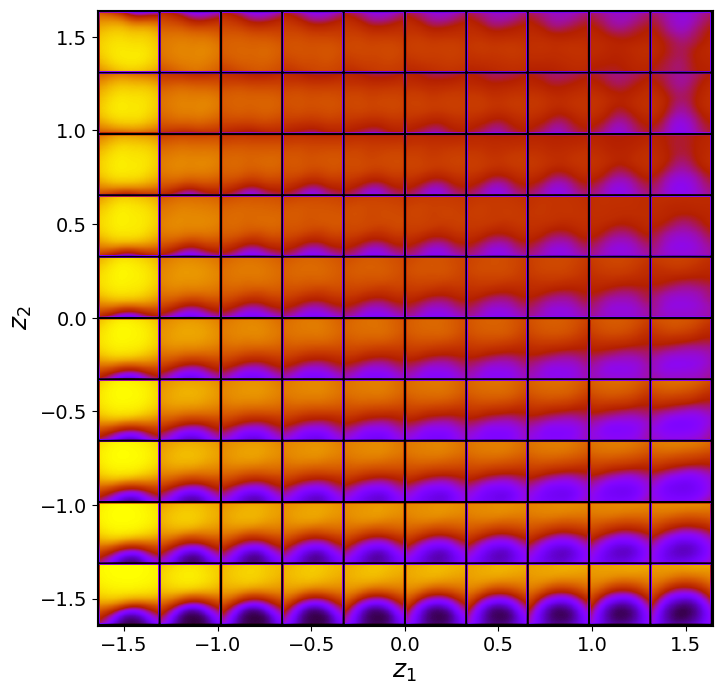

tensor([[[0.6875, 0.6842, 0.6805,  ..., 0.4440, 0.4467, 0.4491],
         [0.7083, 0.7060, 0.7034,  ..., 0.4825, 0.4841, 0.4854],
         [0.7268, 0.7254, 0.7237,  ..., 0.5214, 0.5220, 0.5224],
         ...,
         [0.8137, 0.8184, 0.8231,  ..., 0.8491, 0.8456, 0.8420],
         [0.8046, 0.8093, 0.8141,  ..., 0.8418, 0.8382, 0.8346],
         [0.7949, 0.7996, 0.8043,  ..., 0.8337, 0.8301, 0.8264]],

        [[0.5730, 0.5681, 0.5630,  ..., 0.4249, 0.4304, 0.4358],
         [0.5887, 0.5845, 0.5799,  ..., 0.4433, 0.4486, 0.4539],
         [0.6032, 0.5995, 0.5956,  ..., 0.4634, 0.4685, 0.4735],
         ...,
         [0.6880, 0.6910, 0.6940,  ..., 0.7182, 0.7152, 0.7121],
         [0.6804, 0.6833, 0.6863,  ..., 0.7137, 0.7107, 0.7076],
         [0.6724, 0.6753, 0.6782,  ..., 0.7089, 0.7059, 0.7028]],

        [[0.5412, 0.5361, 0.5308,  ..., 0.4370, 0.4431, 0.4489],
         [0.5552, 0.5505, 0.5456,  ..., 0.4511, 0.4570, 0.4626],
         [0.5684, 0.5642, 0.5598,  ..., 0.4662, 0.4718, 0.

In [ ]:
r_vae.manifold2d(d=10, pad_value=.1)

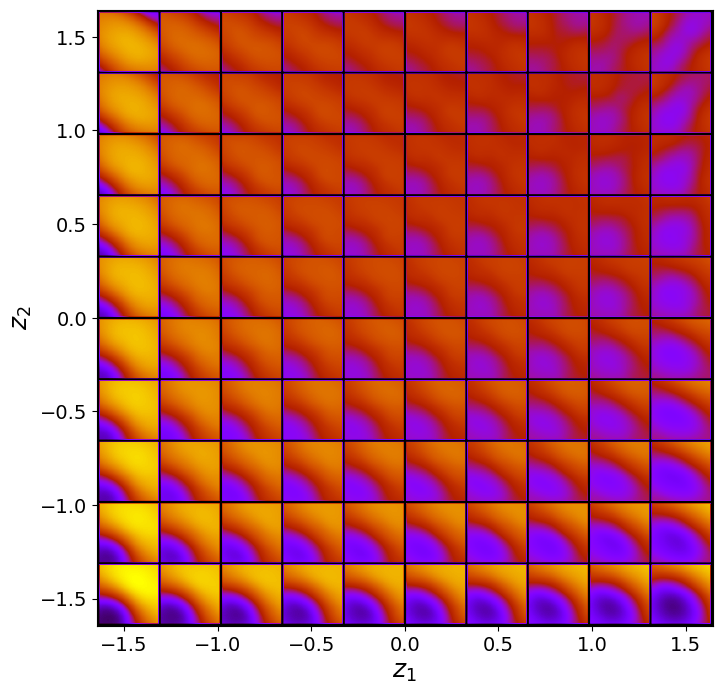

tensor([[[0.7026, 0.7020, 0.7012,  ..., 0.3039, 0.3012, 0.2993],
         [0.7074, 0.7072, 0.7069,  ..., 0.3210, 0.3173, 0.3146],
         [0.7117, 0.7119, 0.7121,  ..., 0.3403, 0.3354, 0.3317],
         ...,
         [0.4429, 0.4612, 0.4792,  ..., 0.7328, 0.7319, 0.7309],
         [0.4200, 0.4389, 0.4576,  ..., 0.7281, 0.7275, 0.7267],
         [0.3976, 0.4168, 0.4359,  ..., 0.7233, 0.7229, 0.7223]],

        [[0.6351, 0.6327, 0.6300,  ..., 0.3572, 0.3562, 0.3558],
         [0.6394, 0.6375, 0.6353,  ..., 0.3686, 0.3673, 0.3666],
         [0.6431, 0.6416, 0.6399,  ..., 0.3807, 0.3790, 0.3779],
         ...,
         [0.4361, 0.4440, 0.4521,  ..., 0.6503, 0.6500, 0.6494],
         [0.4259, 0.4339, 0.4421,  ..., 0.6471, 0.6469, 0.6465],
         [0.4158, 0.4239, 0.4323,  ..., 0.6437, 0.6437, 0.6435]],

        [[0.6020, 0.5995, 0.5969,  ..., 0.3807, 0.3795, 0.3786],
         [0.6054, 0.6033, 0.6010,  ..., 0.3885, 0.3872, 0.3861],
         [0.6085, 0.6067, 0.6047,  ..., 0.3969, 0.3954, 0.

In [ ]:
r_vae.manifold2d(d=10, pad_value=.1)

Text(0.5, 1.0, '$z_2$')

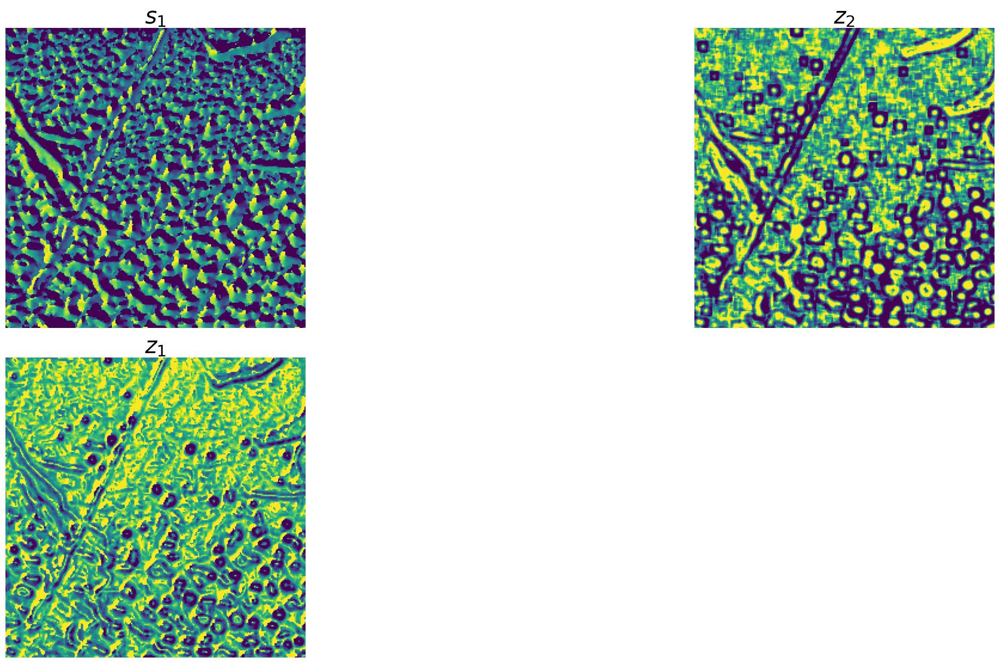

In [ ]:
z_mean, z_sd = r_vae.encode(train_data)
fig = plt.figure(constrained_layout=True, figsize=(25, 12))
gs = fig.add_gridspec(2, 2)

ax2 = fig.add_subplot(gs[0, 0])
z_img = z_mean[:, 0].reshape(d1,d2)
z = ax2.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax2)
#cax2 = divider.append_axes("right", size="5%", pad=0.1)
#cbar2 = fig.colorbar(z, cax=cax2)
ax2.axis('off')
ax2.set_title('$s_1$')

ax3 = fig.add_subplot(gs[1, 0])
z_img = z_mean[:, 1].reshape(d1,d2)
z = ax3.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax3)
#cax3 = divider.append_axes("right", size="5%", pad=0.1)
#cbar3 = fig.colorbar(z, cax=cax3)
ax3.axis('off')
ax3.set_title('$z_1$')

ax4 = fig.add_subplot(gs[0, 1])
z_img = z_mean[:, 2].reshape(d1,d2)
z = ax4.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax4)
#cax4 = divider.append_axes("right", size="5%", pad=0.1)
#cbar4 = fig.colorbar(z, cax=cax4)
ax4.axis('off')
ax4.set_title('$z_2$')


Text(0.5, 1.0, '$z_2$')

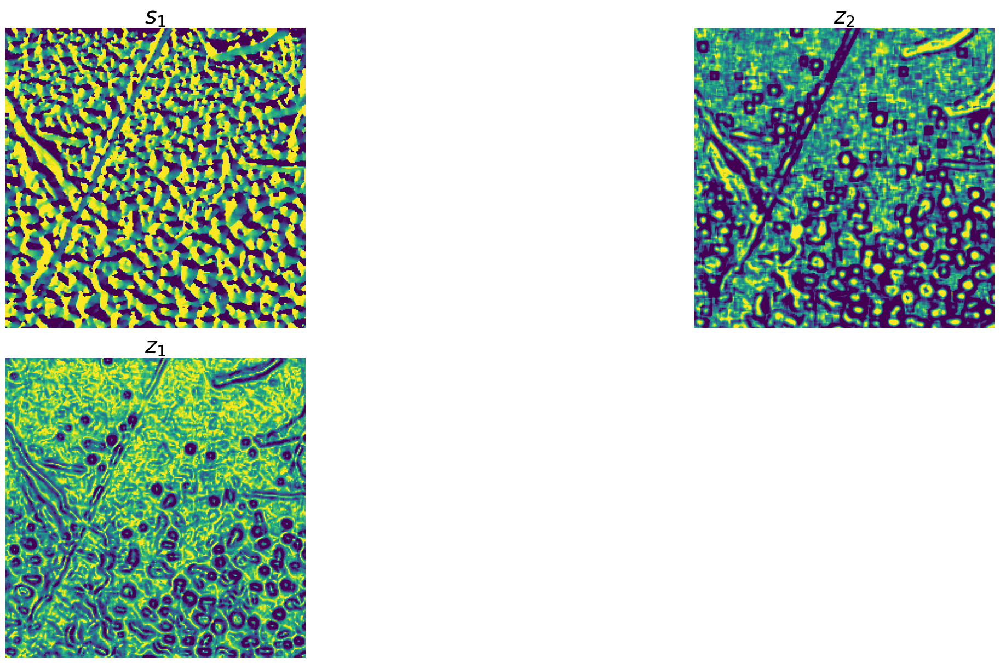

In [ ]:
z_mean, z_sd = r_vae.encode(train_data)
fig = plt.figure(constrained_layout=True, figsize=(25, 12))
gs = fig.add_gridspec(2, 2)

ax2 = fig.add_subplot(gs[0, 0])
z_img = z_mean[:, 0].reshape(d1,d2)
z = ax2.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax2)
#cax2 = divider.append_axes("right", size="5%", pad=0.1)
#cbar2 = fig.colorbar(z, cax=cax2)
ax2.axis('off')
ax2.set_title('$s_1$')

ax3 = fig.add_subplot(gs[1, 0])
z_img = z_mean[:, 1].reshape(d1,d2)
z = ax3.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax3)
#cax3 = divider.append_axes("right", size="5%", pad=0.1)
#cbar3 = fig.colorbar(z, cax=cax3)
ax3.axis('off')
ax3.set_title('$z_1$')

ax4 = fig.add_subplot(gs[0, 1])
z_img = z_mean[:, 2].reshape(d1,d2)
z = ax4.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax4)
#cax4 = divider.append_axes("right", size="5%", pad=0.1)
#cbar4 = fig.colorbar(z, cax=cax4)
ax4.axis('off')
ax4.set_title('$z_2$')


torch.Size([63001, 3]) torch.Size([63001, 3])


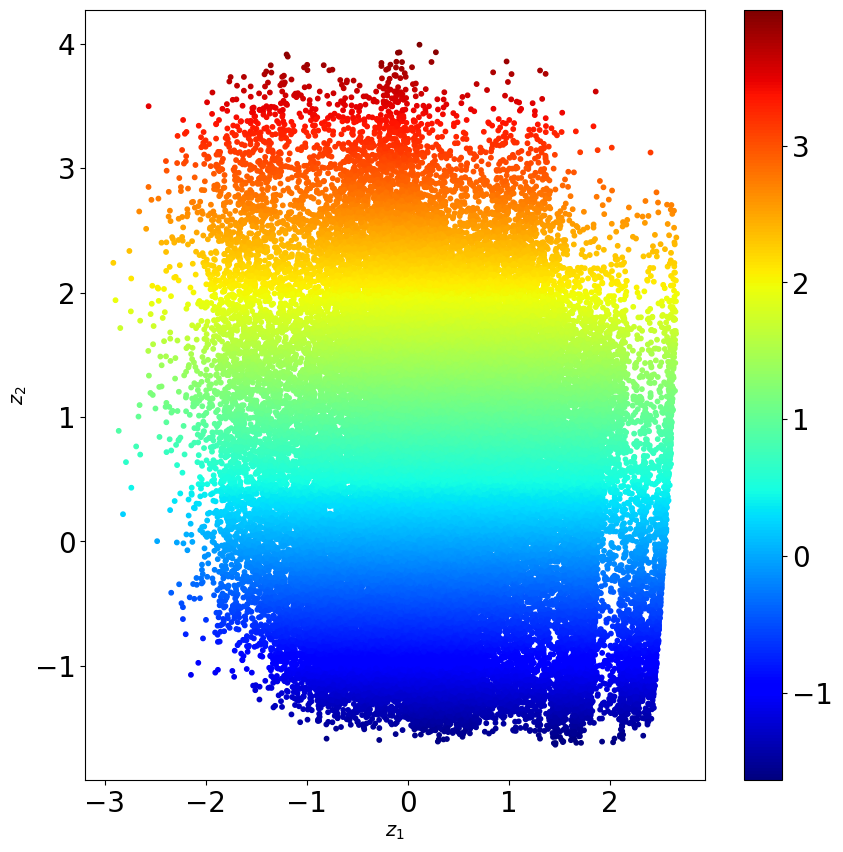

In [ ]:
train_D = train_loader.dataset.tensors[0]
#train_data = traj_sampled
z_mean, z_sd = r_vae.encode(train_D)
print(z_mean.shape, z_mean.shape)

plt.figure(figsize=(10, 10))

plt.scatter(z_mean[:, -2], z_mean[:, -1], s=10, c=z_mean[:, 2], cmap='jet')

plt.xlabel("$z_1$", fontsize=14)
plt.ylabel("$z_2$", fontsize=14)
plt.colorbar()
plt.show()

torch.Size([63001, 3]) torch.Size([63001, 3])


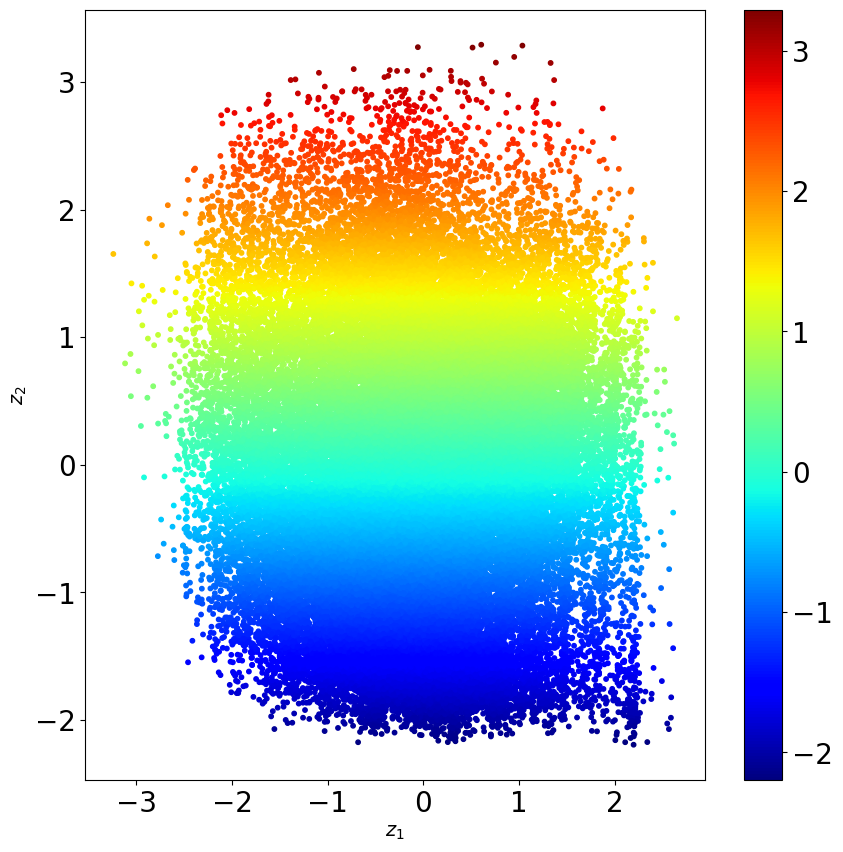

In [ ]:
train_D = train_loader.dataset.tensors[0]
#train_data = traj_sampled
z_mean, z_sd = r_vae.encode(train_D)
print(z_mean.shape, z_mean.shape)

plt.figure(figsize=(10, 10))

plt.scatter(z_mean[:, -2], z_mean[:, -1], s=10, c=z_mean[:, 2], cmap='jet')

plt.xlabel("$z_1$", fontsize=14)
plt.ylabel("$z_2$", fontsize=14)
plt.colorbar()
plt.show()

In [ ]:
z = torch.vstack((z_mean[:, -2], z_mean[:, -1]))
z = torch.transpose(z, 0 ,1)
z.shape

torch.Size([63001, 2])

In [ ]:
ssim_image = np.zeros_like(train_data)
for i in range(0, z.shape[0]):
  # print(i)
  input_img = train_data[i,:,:].numpy()
  decoded = r_vae.decode(z[i,:]).numpy()
  recon_img = decoded[0, :, :]
  ssim_image[i, :, :] = (input_img-recon_img)**2

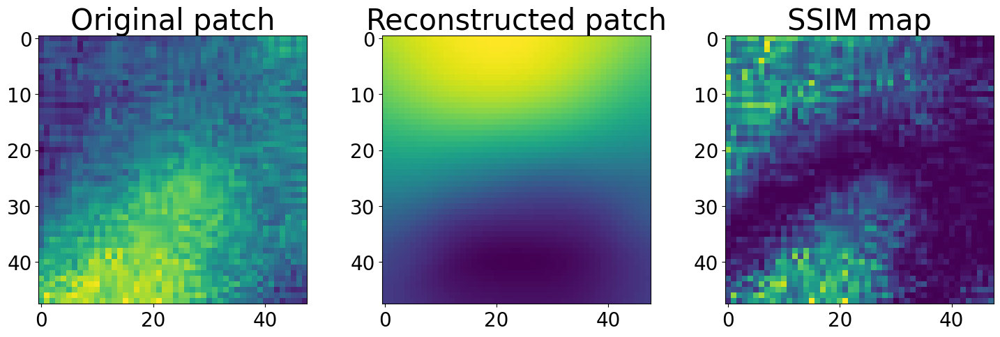

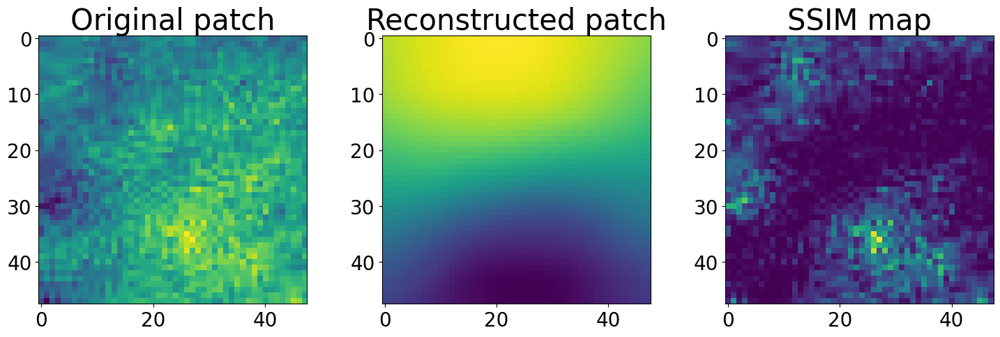

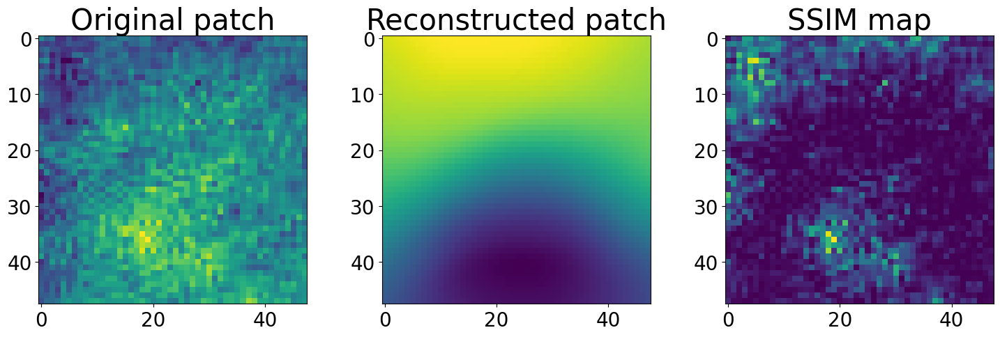

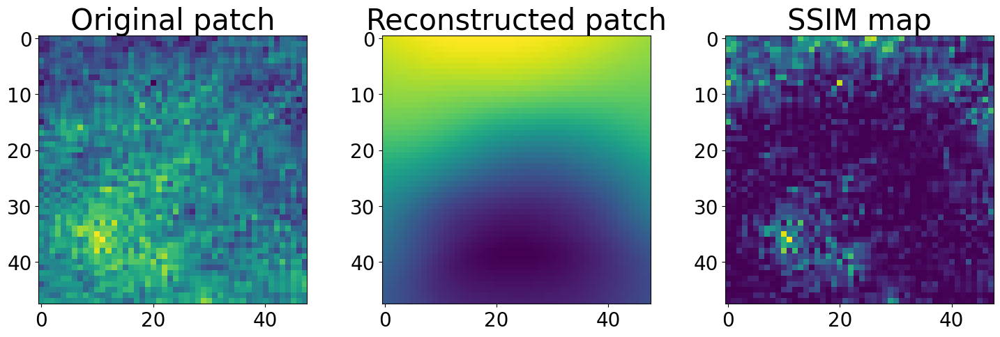

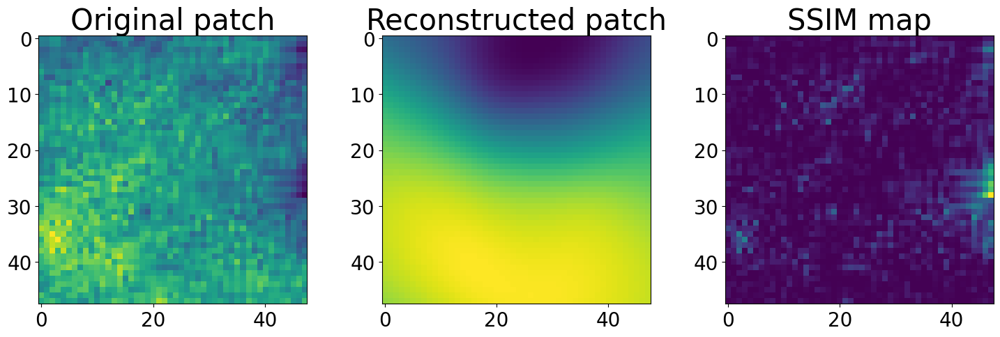

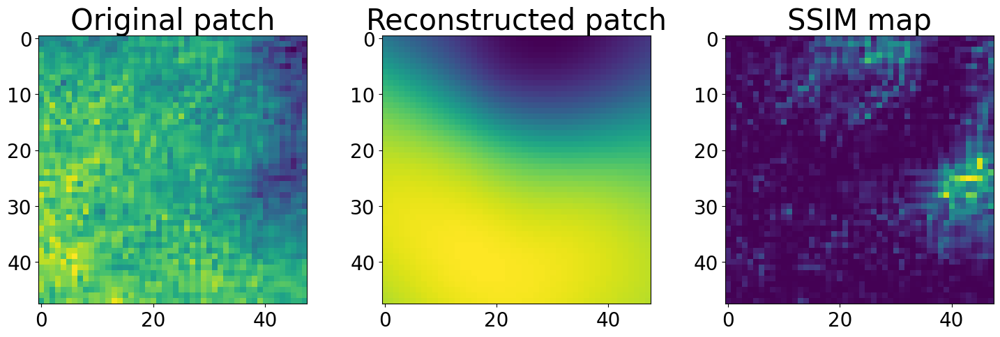

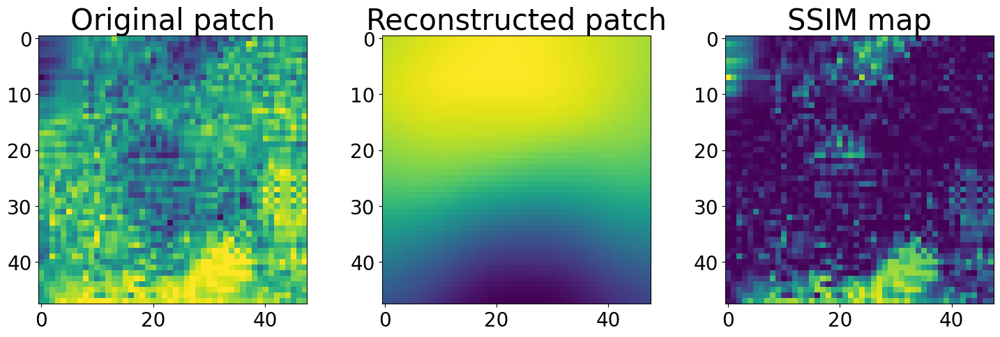

In [ ]:
#SSIM map between first original and reconstructed image patch
fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
ax[0].imshow(train_data[0,:,:])
ax[0].set_title("Original patch")
decoded = r_vae.decode(z[0,:]).numpy()
ax[1].imshow(decoded[0,:,:].squeeze())
ax[1].set_title("Reconstructed patch")
ax[2].imshow(ssim_image[0, :, :])
ax[2].set_title("SSIM map")
plt.show()

for i in range(0, 5):
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
  ax[0].imshow(train_data[i+100,:,:])
  ax[0].set_title("Original patch")
  decoded = r_vae.decode(z[i+100,:]).numpy()
  ax[1].imshow(decoded[0,:,:].squeeze())
  ax[1].set_title("Reconstructed patch")
  ax[2].imshow(ssim_image[i+100, :, :])
  ax[2].set_title("SSIM map")
  plt.show()

#Last reconstructed image
fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
ax[0].imshow(train_data[-1,:,:])
ax[0].set_title("Original patch")
decoded = r_vae.decode(z[-1,:]).numpy()
ax[1].imshow(decoded[0,:,:].squeeze())
ax[1].set_title("Reconstructed patch")
ax[2].imshow(ssim_image[-1, :, :])
ax[2].set_title("SSIM map")
plt.show()


In [ ]:
ssim_image_fullmap = np.zeros(z.shape[0])
d =  np.sqrt(z.shape[0])
for i in range(0, z.shape[0]):
  # print(i)
  input_img = train_data[i,:,:].numpy()
  decoded = r_vae.decode(z[i,:]).numpy()
  recon_img = decoded[0, :, :]
  ssim_image_fullmap[i] = ssim(input_img, recon_img, data_range=recon_img.max() - recon_img.min())
ssim_image_fullmap= np.reshape(ssim_image_fullmap, (d1,d2))

In [ ]:
z1 = denoise_bilateral(ssim_image_fullmap, sigma_color=0.05, sigma_spatial=5)
z1.shape

(251, 251)

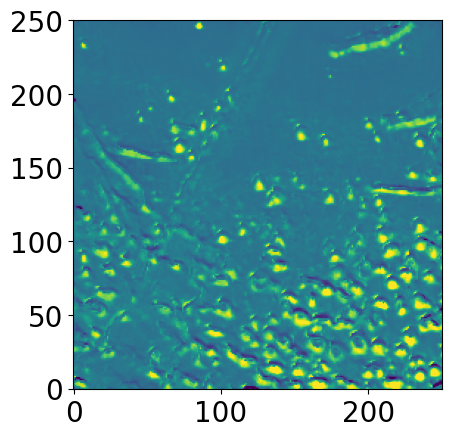

In [ ]:
plt.imshow(z1, cmap="viridis", origin="lower", vmin=z1.min()/1.5, vmax=z1.max()/1.5)

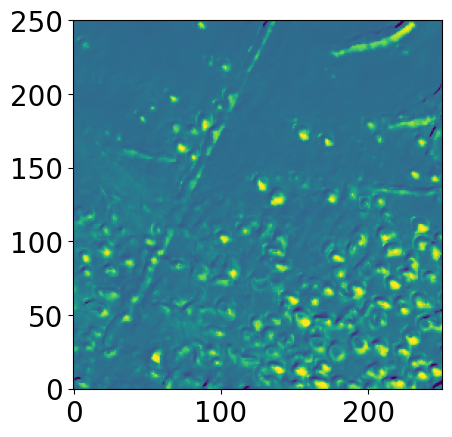

In [ ]:
plt.imshow(z1, cmap="viridis", origin="lower", vmin=z1.min()/1.5, vmax=z1.max()/1.5)

#shr-VAE

In [ ]:
in_dim = (window_size,window_size)

# Initialize shift-invariant VAE
shr_vae = pv.models.iVAE(in_dim, latent_dim=2, invariances = ['r','t'], seed=1, dx_prior=0.5, dy_prior=0.5)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(shr_vae)

# Train for n epochs:
kl_scale = torch.linspace(0.01, 0.05, 50)
for e in range(50):
    sc = kl_scale[e] if e < len(kl_scale) else kl_scale[-1]
    trainer.step(train_loader, scale_factor=sc)
    trainer.print_statistics()

Epoch: 1 Training loss: 1545.3356
Epoch: 2 Training loss: 1516.8225
Epoch: 3 Training loss: 1503.1581
Epoch: 4 Training loss: 1492.0938
Epoch: 6 Training loss: 1486.8719
Epoch: 7 Training loss: 1485.7863
Epoch: 8 Training loss: 1484.8589
Epoch: 9 Training loss: 1483.2715
Epoch: 10 Training loss: 1482.5205
Epoch: 11 Training loss: 1481.1924
Epoch: 12 Training loss: 1480.2115
Epoch: 13 Training loss: 1479.5097
Epoch: 14 Training loss: 1478.3365
Epoch: 15 Training loss: 1478.8957
Epoch: 16 Training loss: 1477.9682
Epoch: 17 Training loss: 1477.2800
Epoch: 18 Training loss: 1477.3901
Epoch: 19 Training loss: 1476.6373
Epoch: 20 Training loss: 1476.4806
Epoch: 21 Training loss: 1476.2512
Epoch: 22 Training loss: 1475.8453
Epoch: 23 Training loss: 1476.1430
Epoch: 24 Training loss: 1475.6663
Epoch: 25 Training loss: 1475.1045
Epoch: 26 Training loss: 1474.8612
Epoch: 27 Training loss: 1474.5442
Epoch: 28 Training loss: 1474.5950
Epoch: 29 Training loss: 1474.5950
Epoch: 30 Training loss: 147

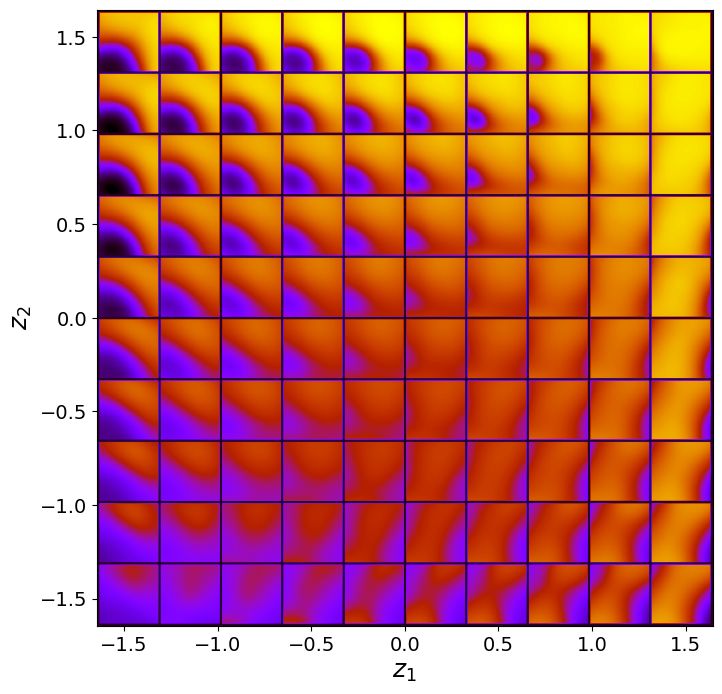

tensor([[[0.8486, 0.8524, 0.8560,  ..., 0.8940, 0.8943, 0.8943],
         [0.8461, 0.8501, 0.8538,  ..., 0.8989, 0.8993, 0.8994],
         [0.8433, 0.8473, 0.8512,  ..., 0.9031, 0.9036, 0.9038],
         ...,
         [0.1115, 0.1077, 0.1046,  ..., 0.8793, 0.8869, 0.8930],
         [0.1120, 0.1081, 0.1049,  ..., 0.8788, 0.8867, 0.8929],
         [0.1133, 0.1092, 0.1058,  ..., 0.8784, 0.8865, 0.8929]],

        [[0.8684, 0.8726, 0.8765,  ..., 0.9222, 0.9205, 0.9185],
         [0.8668, 0.8710, 0.8750,  ..., 0.9255, 0.9238, 0.9219],
         [0.8648, 0.8691, 0.8732,  ..., 0.9282, 0.9267, 0.9249],
         ...,
         [0.1578, 0.1501, 0.1436,  ..., 0.9014, 0.9054, 0.9084],
         [0.1609, 0.1530, 0.1462,  ..., 0.9012, 0.9052, 0.9084],
         [0.1650, 0.1568, 0.1498,  ..., 0.9010, 0.9051, 0.9083]],

        [[0.8828, 0.8869, 0.8909,  ..., 0.9321, 0.9299, 0.9275],
         [0.8817, 0.8858, 0.8898,  ..., 0.9344, 0.9323, 0.9300],
         [0.8803, 0.8845, 0.8885,  ..., 0.9366, 0.9345, 0.

In [ ]:
shr_vae.manifold2d(d=10, pad_value=.1)

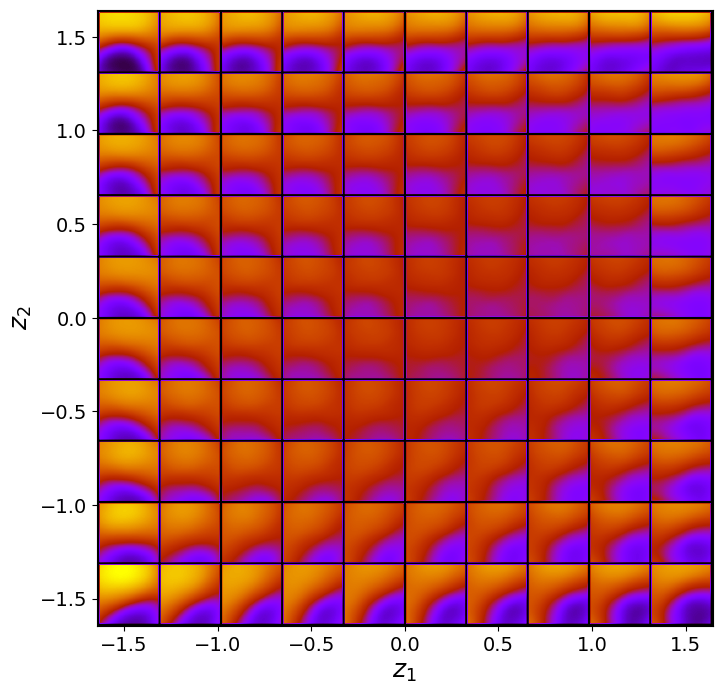

tensor([[[0.8604, 0.8627, 0.8649,  ..., 0.7957, 0.7858, 0.7749],
         [0.8606, 0.8629, 0.8651,  ..., 0.7963, 0.7867, 0.7762],
         [0.8605, 0.8627, 0.8648,  ..., 0.7963, 0.7871, 0.7769],
         ...,
         [0.2233, 0.2114, 0.2013,  ..., 0.5047, 0.5353, 0.5642],
         [0.2233, 0.2122, 0.2027,  ..., 0.4987, 0.5300, 0.5598],
         [0.2249, 0.2144, 0.2054,  ..., 0.4927, 0.5246, 0.5551]],

        [[0.8113, 0.8144, 0.8174,  ..., 0.7526, 0.7406, 0.7274],
         [0.8113, 0.8144, 0.8173,  ..., 0.7527, 0.7406, 0.7275],
         [0.8112, 0.8142, 0.8171,  ..., 0.7525, 0.7405, 0.7275],
         ...,
         [0.2650, 0.2519, 0.2397,  ..., 0.5389, 0.5635, 0.5866],
         [0.2652, 0.2522, 0.2401,  ..., 0.5375, 0.5626, 0.5861],
         [0.2668, 0.2539, 0.2418,  ..., 0.5362, 0.5616, 0.5856]],

        [[0.7955, 0.7986, 0.8015,  ..., 0.7397, 0.7287, 0.7168],
         [0.7952, 0.7982, 0.8011,  ..., 0.7376, 0.7265, 0.7144],
         [0.7947, 0.7977, 0.8005,  ..., 0.7353, 0.7240, 0.

In [ ]:
shr_vae.manifold2d(d=10, pad_value=.1)

Text(0.5, 1.0, '$z_2$')

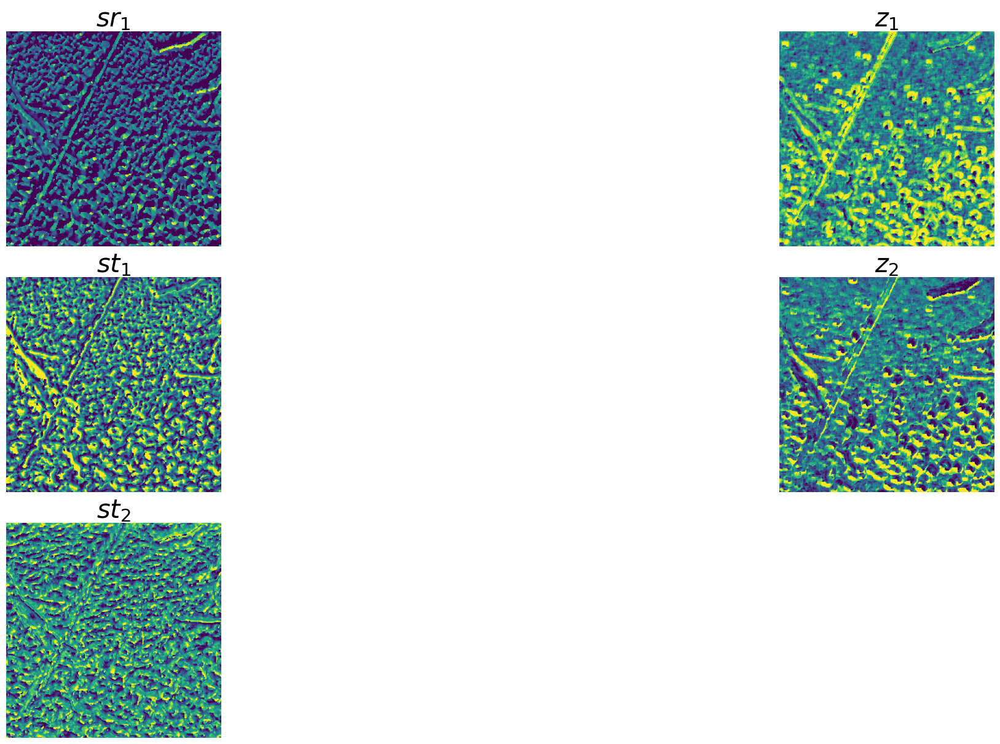

In [ ]:
z_mean, z_sd = shr_vae.encode(train_data)
fig = plt.figure(constrained_layout=True, figsize=(25, 12))
gs = fig.add_gridspec(3, 2)

ax2 = fig.add_subplot(gs[0, 0])
z_img = z_mean[:, 0].reshape(d1,d2)
z = ax2.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax2)
#cax2 = divider.append_axes("right", size="5%", pad=0.1)
#cbar2 = fig.colorbar(z, cax=cax2)
ax2.axis('off')
ax2.set_title('$sr_1$')

ax3 = fig.add_subplot(gs[1, 0])
z_img = z_mean[:, 1].reshape(d1,d2)
z = ax3.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax3)
#cax3 = divider.append_axes("right", size="5%", pad=0.1)
#cbar3 = fig.colorbar(z, cax=cax3)
ax3.axis('off')
ax3.set_title('$st_1$')

ax4 = fig.add_subplot(gs[2, 0])
z_img = z_mean[:, 2].reshape(d1,d2)
z = ax4.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax4)
#cax4 = divider.append_axes("right", size="5%", pad=0.1)
#cbar4 = fig.colorbar(z, cax=cax4)
ax4.axis('off')
ax4.set_title('$st_2$')

ax5 = fig.add_subplot(gs[0, 1])
z_img = z_mean[:, 3].reshape(d1,d2)
z = ax5.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax5)
#cax5 = divider.append_axes("right", size="5%", pad=0.1)
#cbar5 = fig.colorbar(z, cax=cax5)
ax5.axis('off')
ax5.set_title('$z_1$')

ax6 = fig.add_subplot(gs[1, 1])
z_img = z_mean[:, 4].reshape(d1,d2)
z = ax6.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax5)
#cax5 = divider.append_axes("right", size="5%", pad=0.1)
#cbar5 = fig.colorbar(z, cax=cax5)
ax6.axis('off')
ax6.set_title('$z_2$')

Text(0.5, 1.0, '$z_2$')

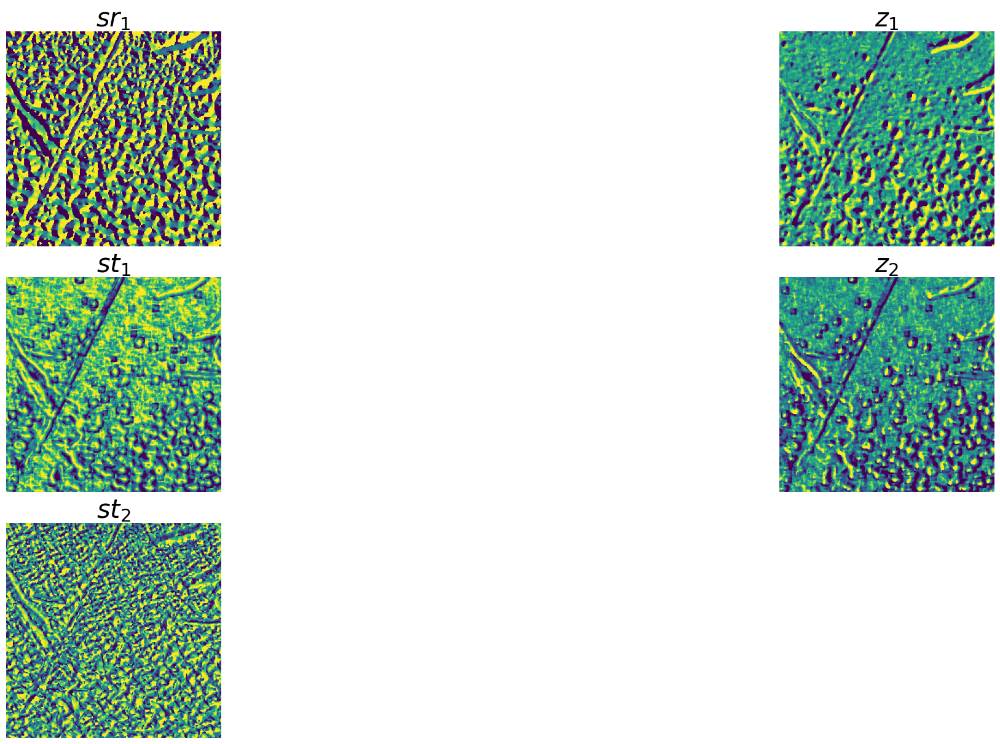

In [ ]:
z_mean, z_sd = shr_vae.encode(train_data)
fig = plt.figure(constrained_layout=True, figsize=(25, 12))
gs = fig.add_gridspec(3, 2)

ax2 = fig.add_subplot(gs[0, 0])
z_img = z_mean[:, 0].reshape(d1,d2)
z = ax2.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax2)
#cax2 = divider.append_axes("right", size="5%", pad=0.1)
#cbar2 = fig.colorbar(z, cax=cax2)
ax2.axis('off')
ax2.set_title('$sr_1$')

ax3 = fig.add_subplot(gs[1, 0])
z_img = z_mean[:, 1].reshape(d1,d2)
z = ax3.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax3)
#cax3 = divider.append_axes("right", size="5%", pad=0.1)
#cbar3 = fig.colorbar(z, cax=cax3)
ax3.axis('off')
ax3.set_title('$st_1$')

ax4 = fig.add_subplot(gs[2, 0])
z_img = z_mean[:, 2].reshape(d1,d2)
z = ax4.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax4)
#cax4 = divider.append_axes("right", size="5%", pad=0.1)
#cbar4 = fig.colorbar(z, cax=cax4)
ax4.axis('off')
ax4.set_title('$st_2$')

ax5 = fig.add_subplot(gs[0, 1])
z_img = z_mean[:, 3].reshape(d1,d2)
z = ax5.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax5)
#cax5 = divider.append_axes("right", size="5%", pad=0.1)
#cbar5 = fig.colorbar(z, cax=cax5)
ax5.axis('off')
ax5.set_title('$z_1$')

ax6 = fig.add_subplot(gs[1, 1])
z_img = z_mean[:, 4].reshape(d1,d2)
z = ax6.imshow(z_img, origin="lower", vmin=z_img.min()/2.00005, vmax=z_img.max()/2.00005)
#divider = make_axes_locatable(ax5)
#cax5 = divider.append_axes("right", size="5%", pad=0.1)
#cbar5 = fig.colorbar(z, cax=cax5)
ax6.axis('off')
ax6.set_title('$z_2$')

torch.Size([63001, 5]) torch.Size([63001, 5])


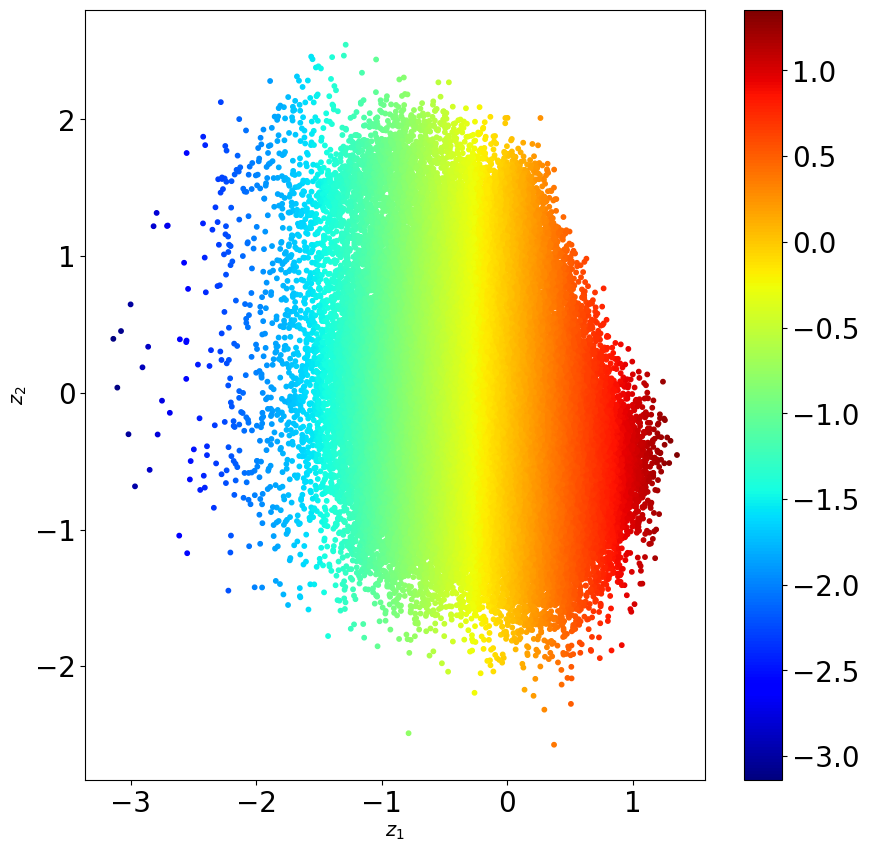

In [ ]:
train_D = train_loader.dataset.tensors[0]
#train_data = traj_sampled
z_mean, z_sd = shr_vae.encode(train_D)
print(z_mean.shape, z_mean.shape)

plt.figure(figsize=(10, 10))

plt.scatter(z_mean[:, -2], z_mean[:, -1], s=10, c=z_mean[:, -2], cmap='jet')

plt.xlabel("$z_1$", fontsize=14)
plt.ylabel("$z_2$", fontsize=14)
plt.colorbar()
plt.show()

torch.Size([63001, 5]) torch.Size([63001, 5])


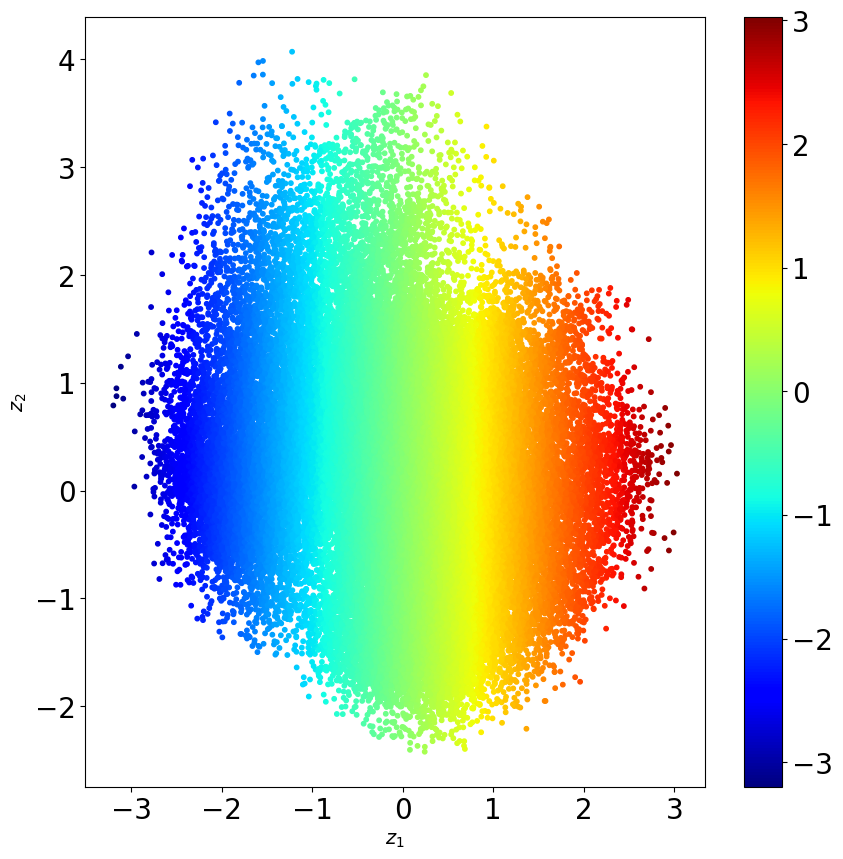

In [ ]:
train_D = train_loader.dataset.tensors[0]
#train_data = traj_sampled
z_mean, z_sd = shr_vae.encode(train_D)
print(z_mean.shape, z_mean.shape)

plt.figure(figsize=(10, 10))

plt.scatter(z_mean[:, -2], z_mean[:, -1], s=10, c=z_mean[:, -2], cmap='jet')

plt.xlabel("$z_1$", fontsize=14)
plt.ylabel("$z_2$", fontsize=14)
plt.colorbar()
plt.show()

In [ ]:
z = torch.vstack((z_mean[:, -2], z_mean[:, -1]))
z = torch.transpose(z, 0 ,1)
z.shape

torch.Size([63001, 2])

In [ ]:
ssim_image = np.zeros_like(train_data)
for i in range(0, z.shape[0]):
  # print(i)
  input_img = train_data[i,:,:].numpy()
  decoded = shr_vae.decode(z[i,:]).numpy()
  recon_img = decoded[0, :, :]
  ssim_image[i, :, :] = (input_img-recon_img)**2

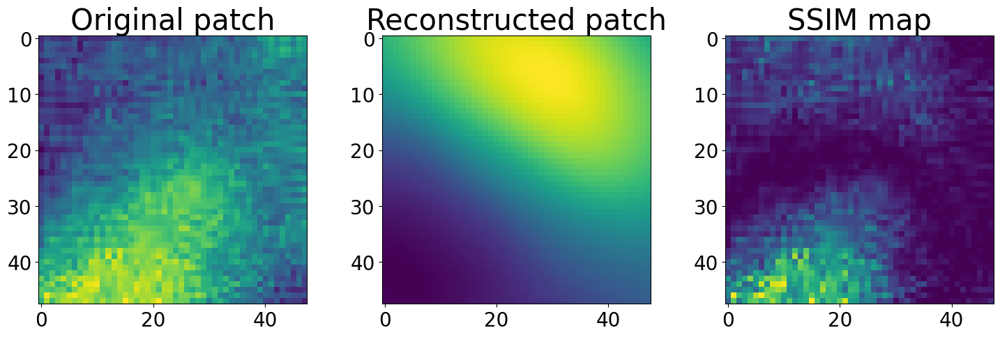

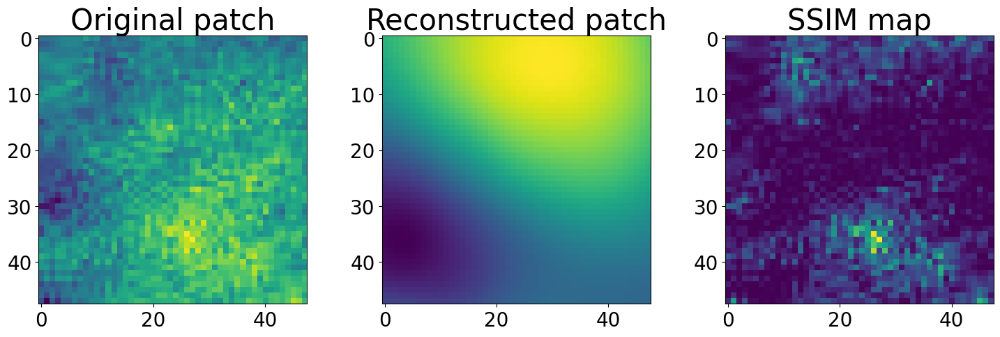

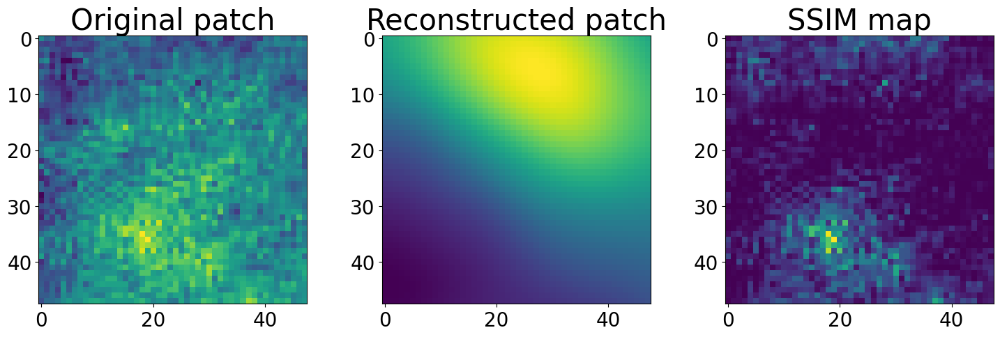

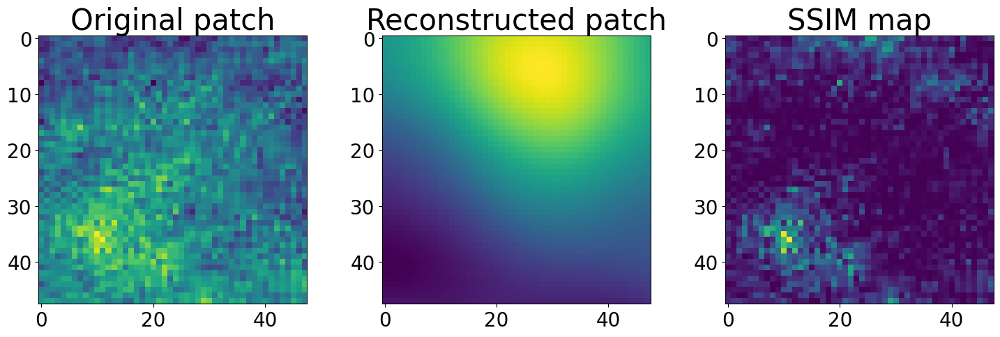

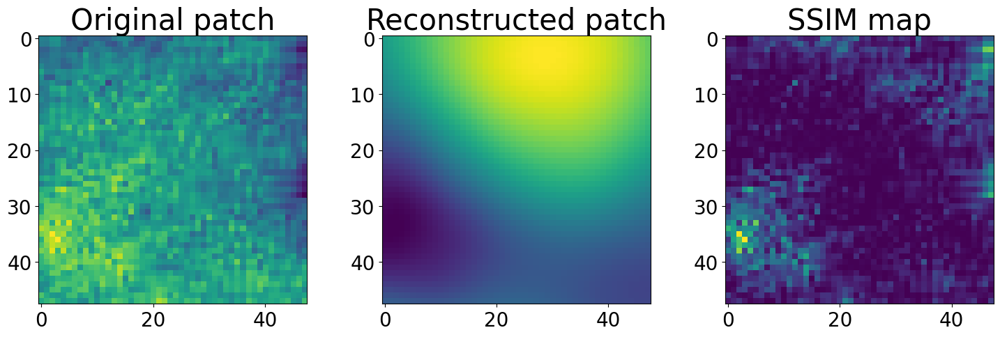

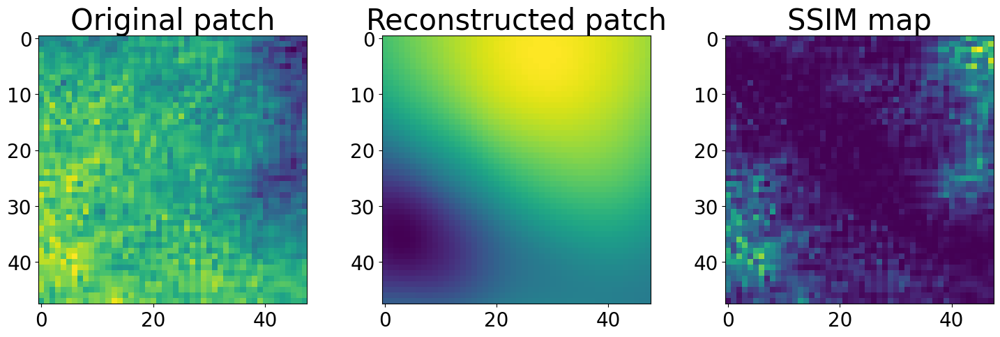

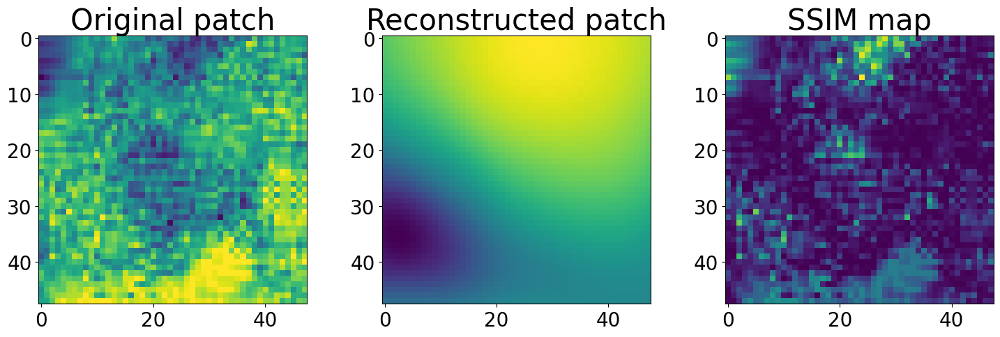

In [ ]:
#SSIM map between first original and reconstructed image patch
fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
ax[0].imshow(train_data[0,:,:])
ax[0].set_title("Original patch")
decoded = shr_vae.decode(z[0,:]).numpy()
ax[1].imshow(decoded[0,:,:].squeeze())
ax[1].set_title("Reconstructed patch")
ax[2].imshow(ssim_image[0, :, :])
ax[2].set_title("SSIM map")
plt.show()

for i in range(0, 5):
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
  ax[0].imshow(train_data[i+100,:,:])
  ax[0].set_title("Original patch")
  decoded = shr_vae.decode(z[i+100,:]).numpy()
  ax[1].imshow(decoded[0,:,:].squeeze())
  ax[1].set_title("Reconstructed patch")
  ax[2].imshow(ssim_image[i+100, :, :])
  ax[2].set_title("SSIM map")
  plt.show()

#Last reconstructed image
fig, ax = plt.subplots(nrows=1, ncols=3, figsize= (18, 5))
ax[0].imshow(train_data[-1,:,:])
ax[0].set_title("Original patch")
decoded = shr_vae.decode(z[-1,:]).numpy()
ax[1].imshow(decoded[0,:,:].squeeze())
ax[1].set_title("Reconstructed patch")
ax[2].imshow(ssim_image[-1, :, :])
ax[2].set_title("SSIM map")
plt.show()


In [ ]:
ssim_image_fullmap = np.zeros(z.shape[0])
d =  np.sqrt(z.shape[0])
for i in range(0, z.shape[0]):
  # print(i)
  input_img = train_data[i,:,:].numpy()
  decoded = shr_vae.decode(z[i,:]).numpy()
  recon_img = decoded[0, :, :]
  ssim_image_fullmap[i] = ssim(input_img, recon_img, data_range=recon_img.max() - recon_img.min())
ssim_image_fullmap= np.reshape(ssim_image_fullmap, (d1,d2))

In [ ]:
z1 = denoise_bilateral(ssim_image_fullmap, sigma_color=0.05, sigma_spatial=5)
z1.shape

(251, 251)

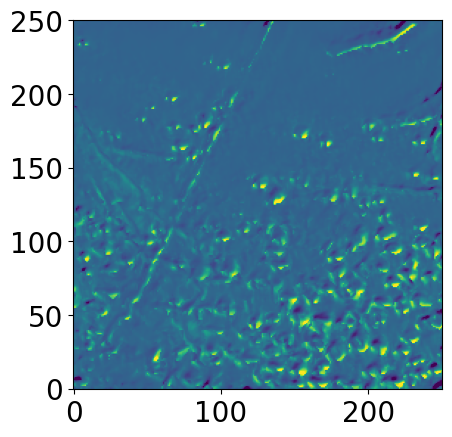

In [ ]:
plt.imshow(z1, cmap="viridis", origin="lower", vmin=z1.min()/1.5, vmax=z1.max()/1.5)

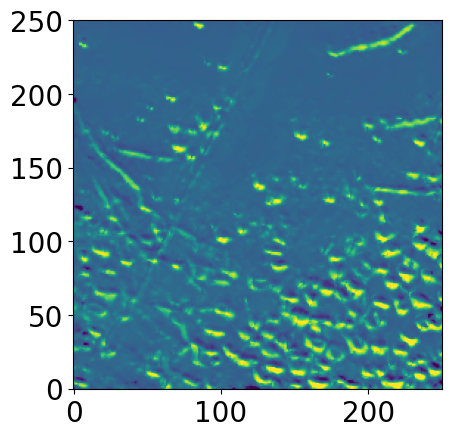

In [ ]:
plt.imshow(z1, cmap="viridis", origin="lower", vmin=z1.min()/1.5, vmax=z1.max()/1.5)